In [1]:
import os
import tempfile

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import rcParams
from matplotlib import cm, colors
import scanpy as sc
import pandas as pd
import seaborn as sb
import scipy as sp
import numpy as np
import torch
from rich import print


# Define the path to the directory you want to change to
new_directory = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined'

# Use os.chdir() to change the working directory
os.chdir(new_directory)

In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined/figures/'
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


In [4]:
adata_all = sc.read('./sysVI_h2m_NEW_allgenes_QC_WORKING.h5ad')

In [5]:
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

# Reload adata_ol_mouse_all

In [4]:
adata_all = sc.read_h5ad('./sysVI_h2m_NEW_all.h5ad')
adata_all

AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2'
    var: 'human_gene_id', 'mouse_gene_id', 'mouse_gene_name', 'human_gene_name'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_eval_colors', 'covariate_categ_orders', 'covariate_key_orders', 'layer_information', 'leiden', 'neighbors', 'publication_colors', 'sy

In [5]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['treatment'].unique()
for condition in unique_conditions:
    print(condition)

LPC

Saline

Cuprizone

Normal

No lesion

MS_patient

In [6]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['condition'].unique()
for condition in unique_conditions:
    print(condition)

Demyelination

Control

Remyelination (late)

Remyelination (early)

Remyelination

MS

In [7]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['diagnosis'].unique()
for condition in unique_conditions:
    print(condition)

Demyelination

Control

Remyelination (late)

Remyelination (early)

Remyelination

CTR

SPMS

RRMS

PPMS

In [8]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['lesion_type'].unique()
for condition in unique_conditions:
    print(condition)

Demyelination

Control

Remyelination (late)

Remyelination (early)

Remyelination

WM

CIL

RL

NAWM

AL

CAL

In [9]:
adata_all.obs['publication'] = adata_all.obs['publication'].astype(str)
adata_all.obs['treatment'] = adata_all.obs['treatment'].astype(str)
adata_all.obs['time'] = adata_all.obs['time'].astype(str)
adata_all.obs['indiv_treatment_time'] = adata_all.obs['publication'] + '_' + adata_all.obs['treatment'] + '_' + adata_all.obs['lesion_type']

In [13]:
adata_all.obs['lesion_type'] = adata_all.obs['lesion_type'].astype(str)
adata_all.obs['pub_treatment_lesion'] = adata_all.obs['publication'] + '_' + adata_all.obs['treatment'] + '_' + adata_all.obs['lesion_type']

In [14]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['pub_treatment_lesion'].unique()
for condition in unique_conditions:
    print(condition)

(this study)_LPC_Demyelination

(this study)_Saline_Control

(this study)_Cuprizone_Demyelination

(this study)_Normal_Control

Pandey et al. 2022_LPC_Demyelination

Pandey et al. 2022_LPC_Remyelination (late)

Pandey et al. 2022_No lesion_Control

Pandey et al. 2022_LPC_Remyelination (early)

Shen et al. 2021_Cuprizone_Remyelination

Shen et al. 2021_Cuprizone_Demyelination

Shen et al. 2021_Normal_Control

Macnair et al. biorxiv_MS_patient_WM

Macnair et al. biorxiv_MS_patient_CIL

Macnair et al. biorxiv_MS_patient_RL

Macnair et al. biorxiv_MS_patient_NAWM

Macnair et al. biorxiv_MS_patient_AL

Macnair et al. biorxiv_MS_patient_CAL

In [17]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    '(this study)_LPC_Demyelination': 'LPC_demyelination',
    '(this study)_Saline_Control': 'baseline_mm',
    '(this study)_Cuprizone_Demyelination': 'cuprizone_demyelination',
    '(this study)_Normal_Control': 'baseline_mm',
    'Pandey et al. 2022_LPC_Demyelination': 'LPC_demyelination',
    'Pandey et al. 2022_LPC_Remyelination (late)': 'LPC_late_remyelination',
    'Pandey et al. 2022_No lesion_Control': 'baseline_mm',
    'Pandey et al. 2022_LPC_Remyelination (early)': 'LPC_early_remyelination',
    'Shen et al. 2021_Cuprizone_Remyelination': 'cuprizone_remyelination',
    'Shen et al. 2021_Cuprizone_Demyelination': 'cuprizone_demyelination',
    'Shen et al. 2021_Normal_Control': 'baseline_mm',
    'Macnair et al. biorxiv_MS_patient_WM': 'baseline_hs',
    'Macnair et al. biorxiv_MS_patient_CIL': 'MS_CIL',
    'Macnair et al. biorxiv_MS_patient_RL': 'MS_RL',
    'Macnair et al. biorxiv_MS_patient_NAWM': 'MS_NAWM',
    'Macnair et al. biorxiv_MS_patient_AL': 'MS_AL',
    'Macnair et al. biorxiv_MS_patient_CAL': 'MS_CAL'
}

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['lesion_status'] = adata_all.obs['pub_treatment_lesion'].map(treatment_map)

In [18]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['lesion_status'].unique()
for condition in unique_conditions:
    print(condition)

LPC_demyelination

baseline_mm

cuprizone_demyelination

LPC_late_remyelination

LPC_early_remyelination

cuprizone_remyelination

baseline_hs

MS_CIL

MS_RL

MS_NAWM

MS_AL

MS_CAL

In [19]:
adata_all.obs['lesion_status'].value_counts()

lesion_status
MS_AL                      71049
MS_NAWM                    58176
MS_CAL                     57991
baseline_hs                53729
MS_RL                      42972
MS_CIL                     37649
baseline_mm                35611
cuprizone_demyelination    23672
LPC_demyelination          21398
cuprizone_remyelination    13329
LPC_late_remyelination     10082
LPC_early_remyelination     7925
Name: count, dtype: int64

# Some QC calcs

In [20]:
adata_all2=adata_all.copy()

In [21]:
adata_all.var["hb"] = adata_all.var_names.str.contains(("Hb"))
adata_all.var["ribo"] = adata_all.var_names.str.startswith(("Rps", "Rpl"))

In [22]:
sc.pp.calculate_qc_metrics(
    adata_all, qc_vars=["ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata_all

AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'human_

In [23]:
for i in ['total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb']:
    adata_all2.obs[i]=adata_all.obs[i]

In [24]:
adata_all2

AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'human_gene_id', 'mouse_gene_id', 'mouse_gene_name', 'human_gene_name'
    uns: '_scvi

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


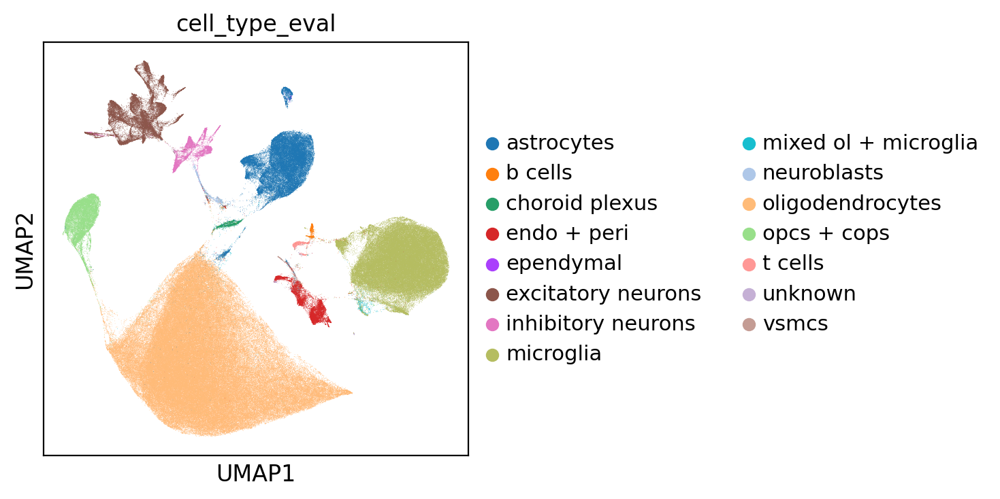

In [25]:
sc.pl.umap(adata_all2, color=['cell_type_eval'])

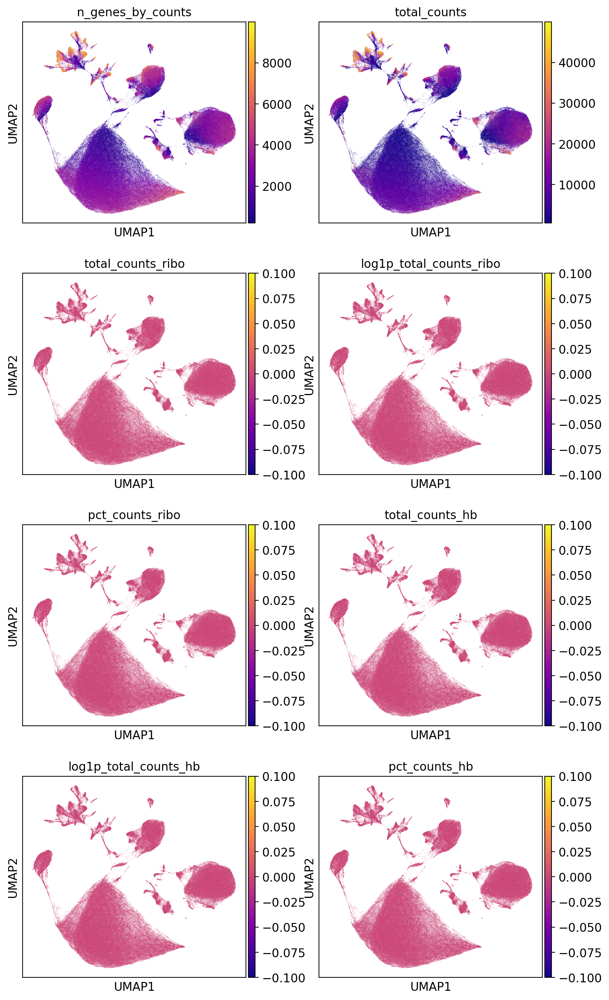

In [26]:
sc.pl.umap(adata_all2, color=['n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 
                              'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'], cmap='plasma',ncols=2)

# Add cell cycle analysis

In [27]:
cell_cycle_genes = [x.strip() for x in open('/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/regev_lab_cell_cycle_genes.txt')]

In [28]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

In [29]:
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_all.var_names]

In [30]:
sc.tl.score_genes_cell_cycle(adata_all, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    558 total control genes are used. (0:00:34)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    602 total control genes are used. (0:00:11)
-->     'phase', cell cycle phase (adata.obs)


In [31]:
adata_all

AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'S_score', 'G2M

In [32]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

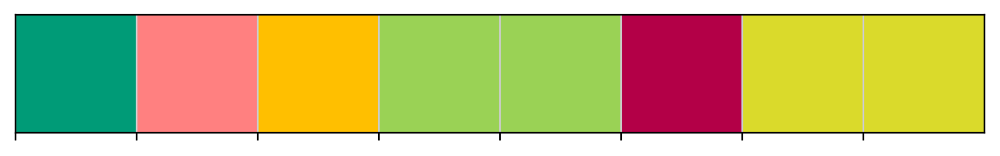

In [33]:
sb.palplot(pair2)

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


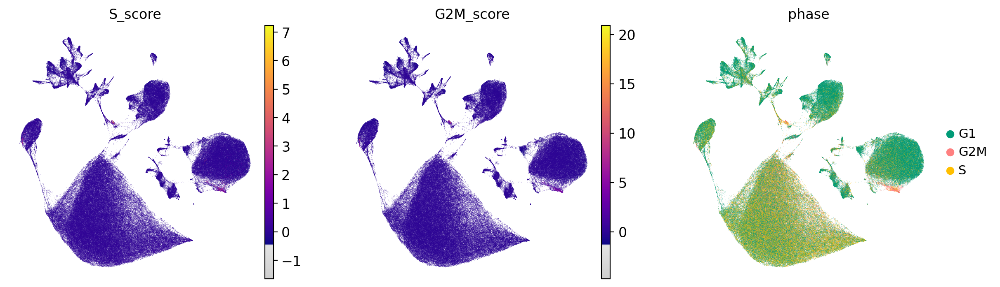

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


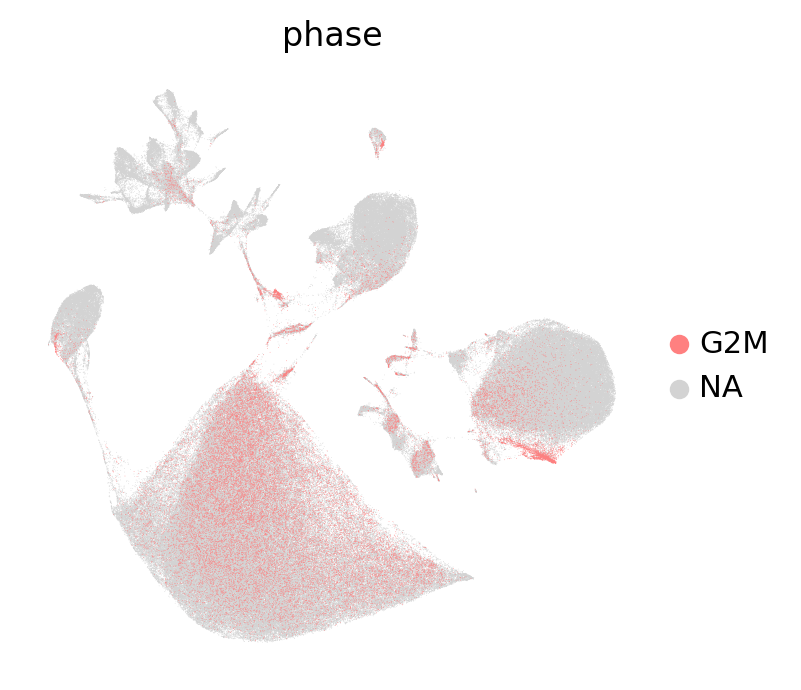

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


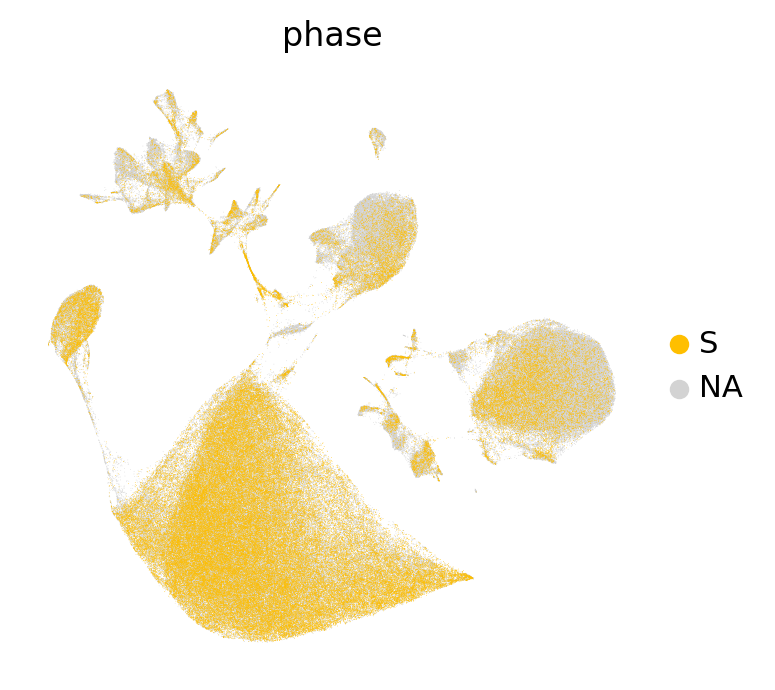

In [34]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.umap(adata_all, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, cmap=mymap2)
sc.pl.umap(adata_all, color='phase',groups=['G2M'],  palette=pair2, use_raw=False, frameon=False)
sc.pl.umap(adata_all, color='phase',groups=['S'],  palette=pair2, use_raw=False, frameon=False)

In [35]:
sc.tl.score_genes(adata_all, list(cell_cycle_genes), score_name='Cycling cells' )

computing score 'Cycling cells'
    finished: added
    'Cycling cells', score of gene set (adata.obs).
    500 total control genes are used. (0:00:15)


In [36]:
sc.tl.score_genes(adata_all, list(s_genes), score_name='S phase' )

computing score 'S phase'
    finished: added
    'S phase', score of gene set (adata.obs).
    649 total control genes are used. (0:00:14)


In [37]:
Ccc = adata_all.obs['Cycling cells'] >0

In [38]:
adata_all.obs['Cycling_cells'] = Ccc
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].astype('category')

In [39]:
cluster2annotation = {
    False : 'resting',
    True : 'cycling',
 }

In [40]:
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].map(cluster2annotation).astype('category')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


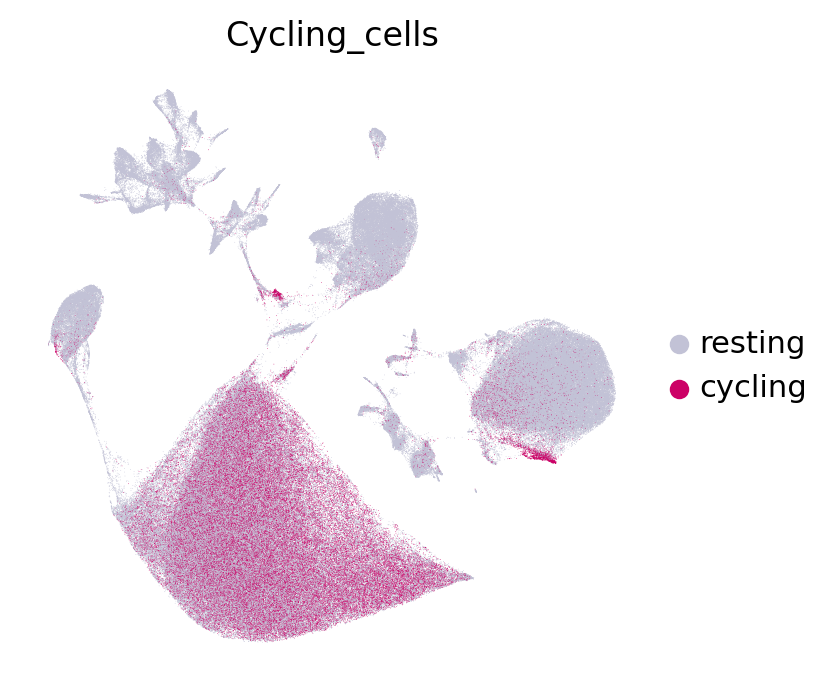

In [41]:
sc.pl.umap(adata_all, color=['Cycling_cells'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [42]:
scells = adata_all.obs['S phase'] >0.05

In [43]:
adata_all.obs['S_phase_cells'] = scells
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].astype('category')

In [44]:
cluster2annotation = {
    False : 'NA',
    True : 'S phase',
 }

In [45]:
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].map(cluster2annotation).astype('category')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


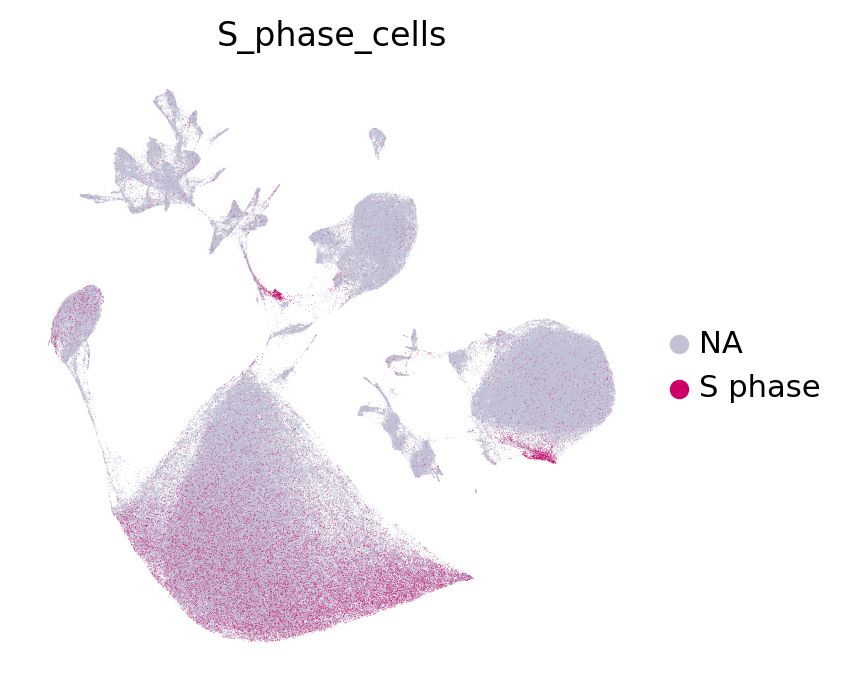

In [46]:
sc.pl.umap(adata_all, color=['S_phase_cells'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

## Code from Koupourtidou Schwarz et al Nat Comm 2024

In [47]:
adata_all

AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'S_score', 'G2M

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


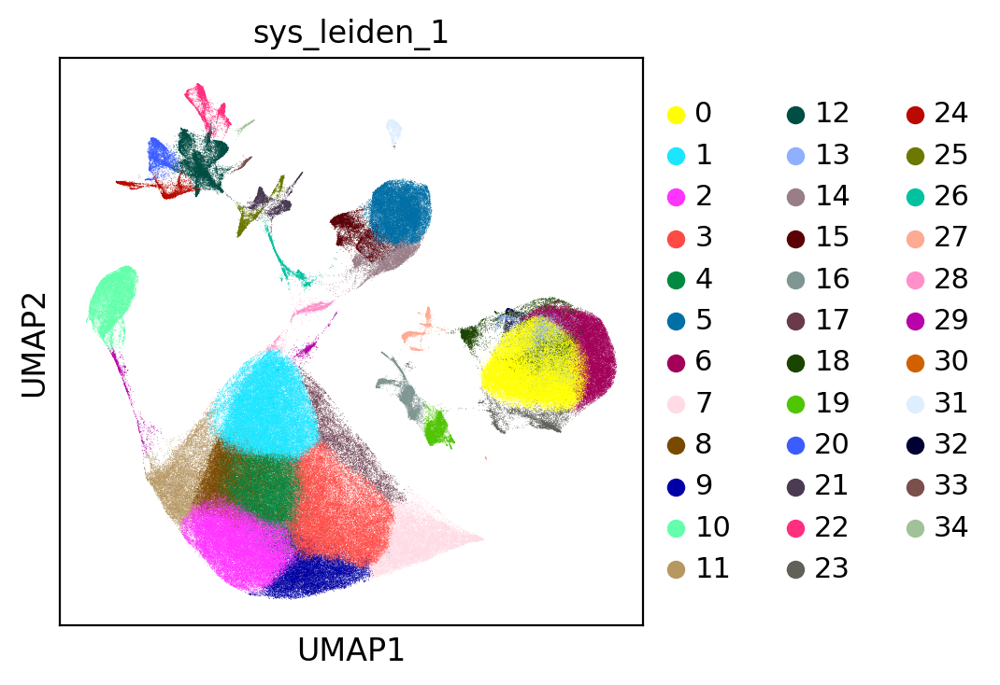

In [48]:
sc.pl.umap(adata_all, color=['sys_leiden_1'])

In [49]:
# Step 1: Get unique batch labels
unique_batches = np.unique(adata_all.obs['sample_id'])

# Step 2: Iterate over each cluster
for cluster in np.unique(adata_all.obs['sys_leiden_1']):
    cluster_indices = adata_all.obs['sys_leiden_1'] == cluster
    batches_in_cluster = adata_all.obs.loc[cluster_indices, 'batch'].unique()
    
    # Step 3: Check if there's only one unique batch label in the cluster
    if len(batches_in_cluster) == 1:
        print(f"Cluster {cluster} contains cells only from sample_id {batches_in_cluster[0]}")

In [50]:
Markers_all_cells ={
    'Microglia': ['TMEM119', 'CX3CR1', 'P2RY12', 'P2RY13', 'GPR34', 'OLFML3', 'SELPLG', 'SPARC', 'FCRLS', 'SIGLECH', 'SLC2A5', 'MAFB', 'PMEPA1', 'CD14'],
    'DAM': ['LPL', 'CST7'], 
    'Macrophages': ['ITGA4', 'TGFB1', 'IFITM2', 'IFITM3', 'TAGLN2', 'F13A1', 'KYNU', 'S100A11', 'S100A6'],
    'BAM': ['CD163', 'MRC1', 'LYVE1', 'SIGLEC1'],
    'Monocytes': ['LY6C2', 'CCR2', 'SPN'],
    'DCs': ['CD24A', 'ITGAX', 'BST2', 'CD209A', 'XCR1', 'CCR7', 'CCR9', 'FLT3', 'ITGAE', 'ITGAM', 'H2-OA', 'TNNI2', 'KCTD14', 'AMICA1', 'KMO', 'HEPACAM2'],
    'NKT cells': ['CD3E', 'KLRB1C', 'NCR1'],
    'T cells': ['CD3D', 'CD3E', 'CD3G', 'LAT', 'BCL11B'],
    'B cells': ['CD19', 'MS4A1', 'SDC1', 'PAX5', 'MS4A1'],
    'Neutrophils': ['S100A9'],
    'Neurons': ['Rbfox3', 'SLC17A7', 'GABRA1', 'CUX1', 'POU3F2', 'BCL11B', 'FOXP2'],
    'OPCs': ['PDGFRA', 'C1QL1'],
    'COPs': ['NEU4', 'BRCA1'],
    'MOL': ['OPALIN', 'NINJ2'],
    'Astrocytes': ['SOX9', 'GFAP', 'ALDH1L1', 'ATP1B2', 'VIM', 'GFAP', 'SLC1A3', 'ALDOC'],
    'Pericytes': ['PECAM1', 'PDGFRB', 'HIGD1B', 'NDUFA4L2', 'RGS5', 'KCNJ8', 'FLT1'],
    'VSMCs': ['ACTA2', 'TAGLN', 'MYH11', 'MUSTN1', 'MAP3K7CL'],
    'VLMCs': ['MGP', 'SLC47A1', 'THBD', 'COL1A1', 'COL1A2'],
    'VECV': ['LY6C1', 'CLDN5', 'LY6A', 'PLTP', 'PGLYRP1', 'SCGB3A1']
}

In [51]:
for names in list(Markers_all_cells):
    sc.tl.score_genes(adata_all, Markers_all_cells[names], score_name=names )

computing score 'Microglia'
    finished: added
    'Microglia', score of gene set (adata.obs).
    300 total control genes are used. (0:00:13)
computing score 'DAM'
    finished: added
    'DAM', score of gene set (adata.obs).
    50 total control genes are used. (0:00:11)
computing score 'Macrophages'
    finished: added
    'Macrophages', score of gene set (adata.obs).
    350 total control genes are used. (0:00:10)
computing score 'BAM'
    finished: added
    'BAM', score of gene set (adata.obs).
    150 total control genes are used. (0:00:11)
computing score 'Monocytes'
    finished: added
    'Monocytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:10)
computing score 'DCs'
    finished: added
    'DCs', score of gene set (adata.obs).
    500 total control genes are used. (0:00:11)
computing score 'NKT cells'
    finished: added
    'NKT cells', score of gene set (adata.obs).
    149 total control genes are used. (0:00:12)
computing score 'T cells'

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


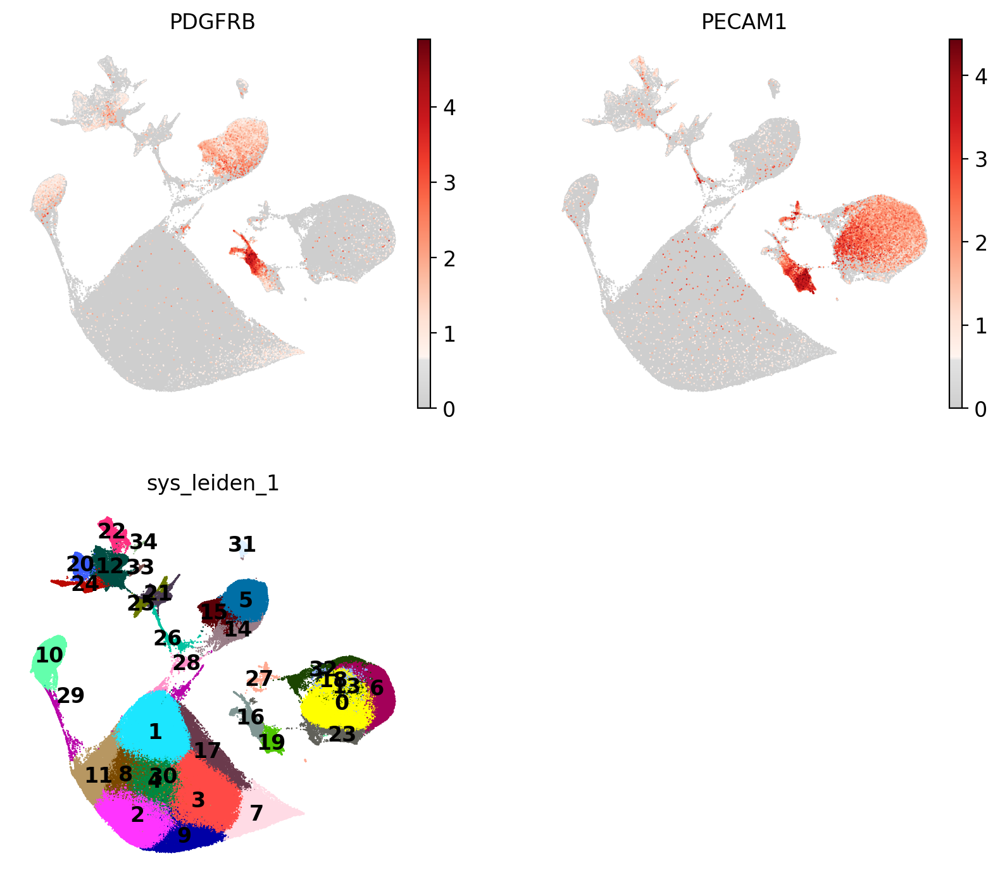

In [72]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['PDGFRB', 'PECAM1', 'sys_leiden_1'],
    frameon=False,
    ncols=2,
    layer='log1p_norm',
    color_map=mymap,
    size=3,
    legend_loc='on data'
)

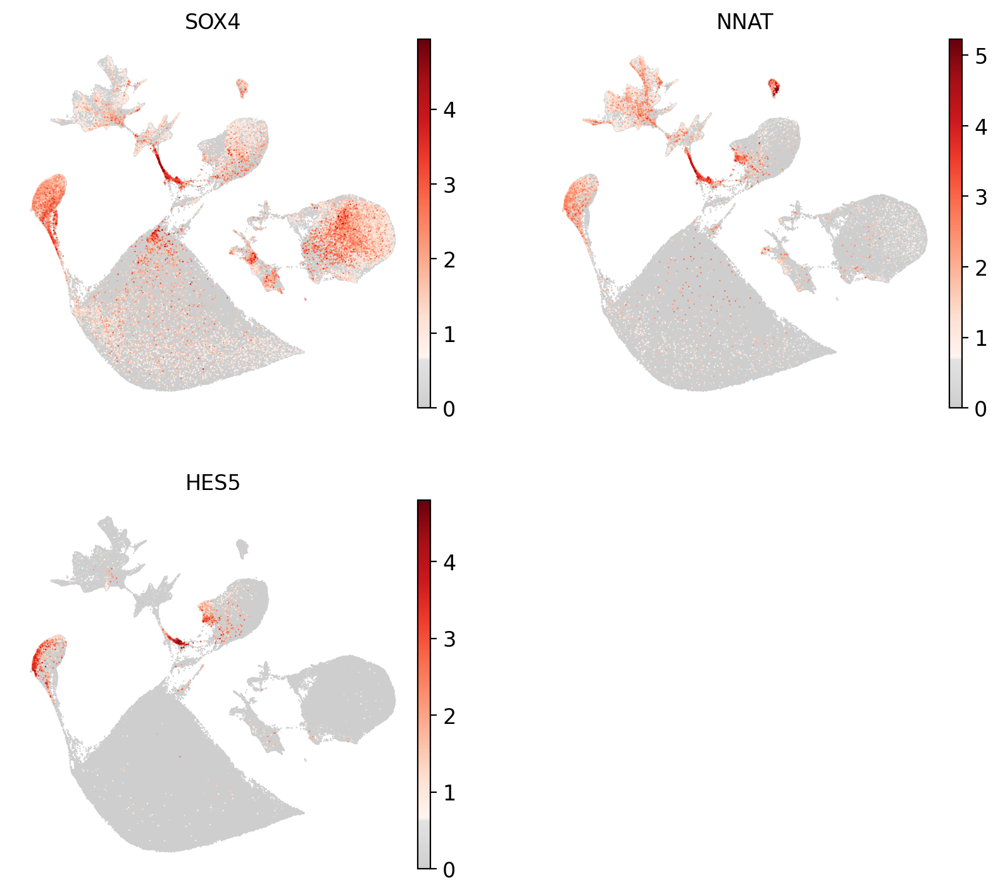

In [81]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['SOX4', 'NNAT', 'HES5'],
    frameon=False,
    ncols=2,
    layer='log1p_norm',
    color_map=mymap,
    size=3,
    legend_loc='on data'
)

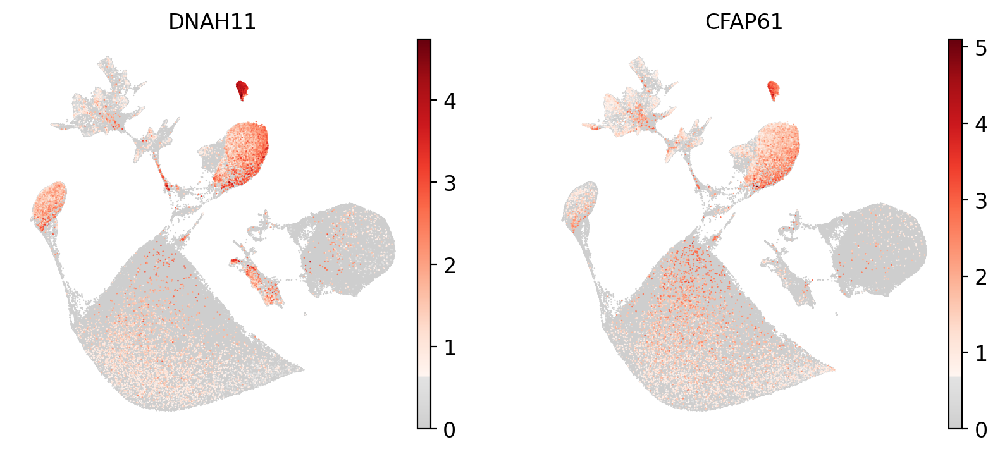

In [80]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.embedding(
    adata_all,
    basis='X_umap',
    color=['DNAH11', 'CFAP61'],
    frameon=False,
    ncols=2,
    layer='log1p_norm',
    color_map=mymap,
    size=3,
    legend_loc='on data'
)

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be r

    with n_comps=50
    finished (0:00:56)
Storing dendrogram info using `.uns['dendrogram_cell_type_eval']`


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


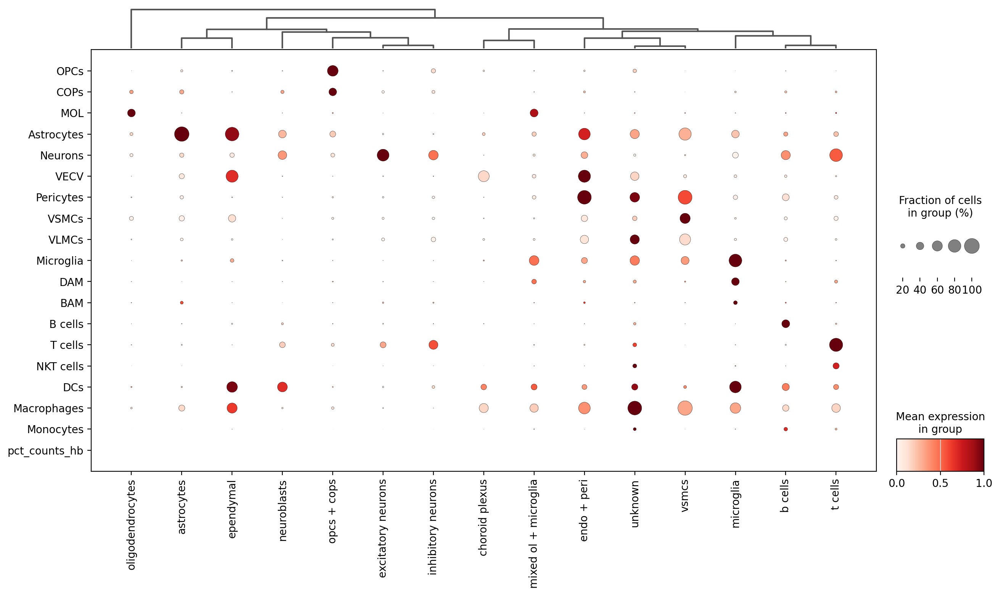

In [52]:
sc.pl.dotplot(adata_all, ['OPCs','COPs', 'MOL',  'Astrocytes', 'Neurons','VECV','Pericytes', 'VSMCs', 'VLMCs',  'Microglia', 'DAM', 'BAM', 'B cells', 'T cells', 'NKT cells', 
                                    'DCs','Macrophages', 'Monocytes', 'pct_counts_hb'], 'cell_type_eval',  standard_scale='var', swap_axes=True, figsize=(15,8),
              var_group_rotation=90, dendrogram=True,)# save='markers_3dpi.png')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_sys_leiden_1']`


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated

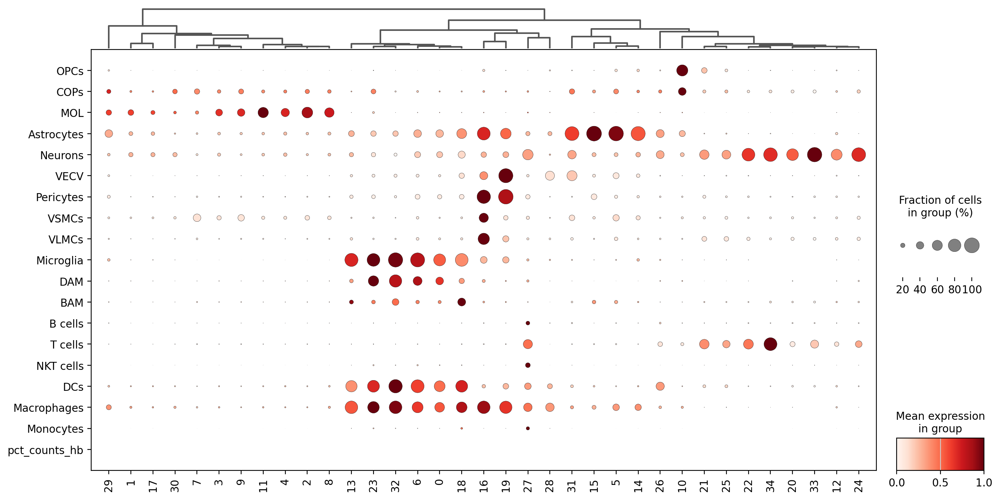

In [53]:
sc.pl.dotplot(adata_all, ['OPCs','COPs', 'MOL',  'Astrocytes', 'Neurons','VECV','Pericytes', 'VSMCs', 'VLMCs',  'Microglia', 'DAM', 'BAM', 'B cells', 'T cells', 'NKT cells', 
                                    'DCs','Macrophages', 'Monocytes', 'pct_counts_hb'], 'sys_leiden_1',  standard_scale='var', swap_axes=True, figsize=(15,8),
              var_group_rotation=90, dendrogram=True,)# save='markers_3dpi.png')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


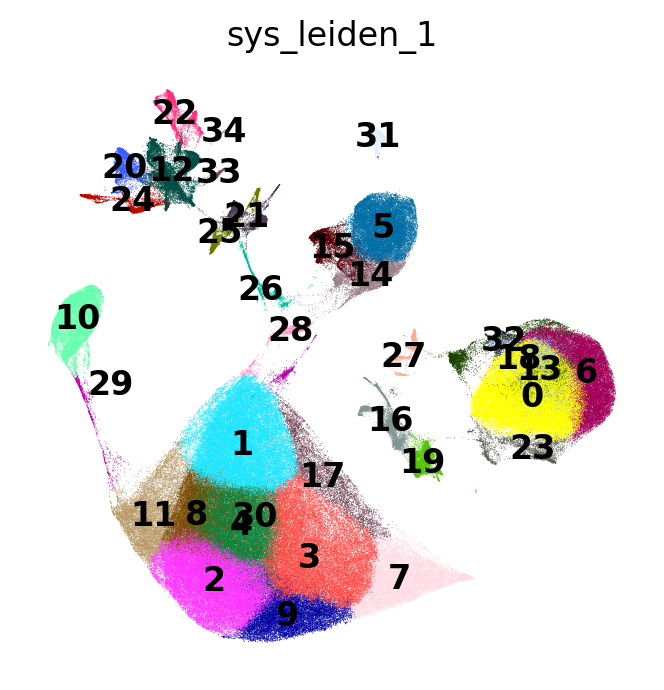

In [54]:
sc.pl.umap(adata_all, color=['sys_leiden_1'], frameon=False, legend_loc='on data')

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


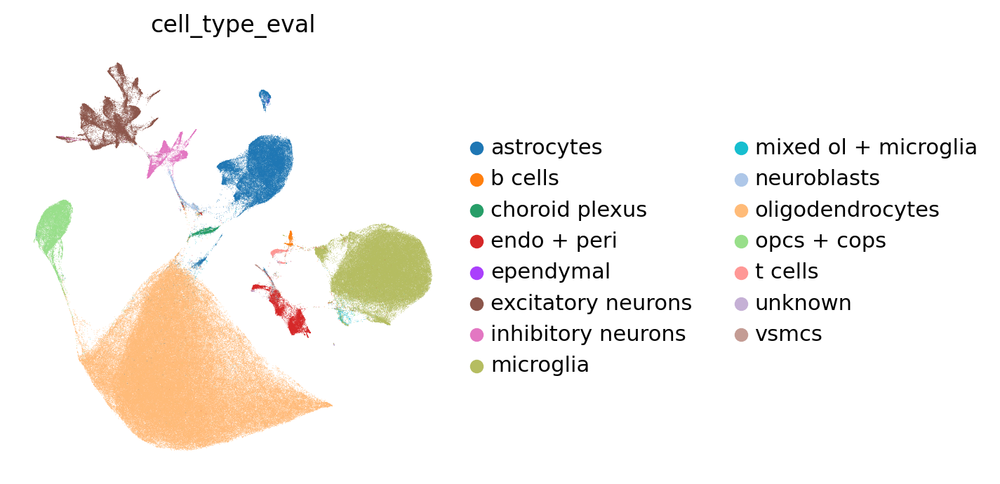

In [55]:
sc.pl.umap(adata_all, color=['cell_type_eval'], frameon=False)

In [56]:
cluster_counts = adata_all.obs['sys_leiden_1'].value_counts()
cluster_counts

sys_leiden_1
0     46439
1     45302
2     44937
3     38709
4     26658
5     24971
6     24550
7     16823
8     16724
9     16651
10    15527
11    15214
12    12937
13     9344
14     7720
15     6691
16     6582
17     6446
18     6180
19     5321
20     4764
21     4431
22     4412
23     4083
24     3823
25     3069
26     2960
27     2899
28     2007
29     1998
30     1899
31     1519
32      900
33      603
34      490
Name: count, dtype: int64

In [61]:
# Convert cluster labels to strings
adata_all.obs['sys_leiden_1'] = adata_all.obs['sys_leiden_1'].astype(str)

# Filter the data for cells in cluster 23
cluster_23_data = adata_all[adata_all.obs['sys_leiden_1'] == '19']

# Check the shape of the filtered data
print("Shape of filtered data:", cluster_23_data.shape)

# Print the first few rows of the filtered data
print("First few rows of filtered data:")
print(cluster_23_data.obs.head())

Shape of filtered data:
(5321, 2904)

First few rows of filtered data:

sample_id   publication   sample_id_anon  \
GCTACCTGTTCCCACT-1_adams_mouse       cl2  (this study)  adams_Sample6_2   
ATGGGAGCAAGTGCAG-1_adams_mouse       cl2  (this study)  adams_Sample6_2   
TAGGAGGCAACGGGTA-1_adams_mouse       cs2  (this study)  adams_Sample4_2   
GATAGAATCATACGAC-1_adams_mouse       cc2  (this study)  adams_Sample2_2   
TGCTTCGCAGTAACCT-1_adams_mouse       cs1  (this study)  adams_Sample3_1   

                               individual_id_anon replicate  treatment  \
GCTACCTGTTCCCACT-1_adams_mouse      adams_Sample6         2        LPC   
ATGGGAGCAAGTGCAG-1_adams_mouse      adams_Sample6         2        LPC   
TAGGAGGCAACGGGTA-1_adams_mouse      adams_Sample4         2     Saline   
GATAGAATCATACGAC-1_adams_mouse      adams_Sample2         2  Cuprizone   
TGCTTCGCAGTAACCT-1_adams_mouse      adams_Sample3         1     Saline   

                                    condition           tissue      time  \
GCTACCTGTTCCCACT-1_adams_mouse  Demyelination  Corpus callosum      7dpl   
ATGGGAGCAAGTGCAG-1_adams_mouse  Demyelination  Corpus callosum      7dpl   
TAGGAGGCAACGGGTA-1_adams_mouse        Control  Corpus callosum  Baseline   
GATAGAATCATACGAC-1_adams_mouse  Demyelination  Corpus callosum   5 weeks   
TGCTTCGCAGTAACCT-1_adams_mouse        Control  Corpus callosum  Baseline   

                               batch  ... Neutrophils   Neurons  OPCs  COPs  \
GCTACCTGTTCCCACT-1_adams_mouse     6  ...       -0.04 -0.172000 -0.02 -0.06   
ATGGGAGCAAGTGCAG-1_adams_mouse     6  ...       -0.02 -0.124000  0.00 -0.02   
TAGGAGGCAACGGGTA-1_adams_mouse     4  ...        0.00 -0.124000 -0.04 -0.03   
GATAGAATCATACGAC-1_adams_mouse     2  ...        0.00  0.086667  0.00 -0.01   
TGCTTCGCAGTAACCT-1_adams_mouse     3  ...       -0.02 -0.076000  0.00  0.00   

                                 MOL  Astrocytes  Pericytes  VSMCs     VLMCs  \
GCTACCTGTTCCCACT-1_adams_mouse -0.43    0.018857   1.029524 -0.068 -0.040000   
ATGGGAGCAAGTGCAG-1_adams_mouse -0.12    0.213714   0.242381 -0.048 -0.006667   
TAGGAGGCAACGGGTA-1_adams_mouse -0.07   -0.096000   1.125714 -0.108 -0.006667   
GATAGAATCATACGAC-1_adams_mouse -0.13   -0.048000   1.096190 -0.044  0.000000   
TGCTTCGCAGTAACCT-1_adams_mouse -0.05    0.388571   0.089524 -0.036 -0.026667   

                                    VECV  
GCTACCTGTTCCCACT-1_adams_mouse -0.040000  
ATGGGAGCAAGTGCAG-1_adams_mouse  0.158667  
TAGGAGGCAACGGGTA-1_adams_mouse  0.436000  
GATAGAATCATACGAC-1_adams_mouse -0.028000  
TGCTTCGCAGTAACCT-1_adams_mouse  0.622667  

[5 rows x 83 columns]

# Rank genes

In [65]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all, groupby='sys_leiden_1', key_added='rank_genes_annotated', 
                        method='t-test_overestim_var', use_raw=True)

ranking genes


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:419: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once usi

    finished: added to `.uns['rank_genes_annotated']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:17)


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-pa

In [67]:
sc.tl.dendrogram(adata_all, 'sys_leiden_1')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_sys_leiden_1']`


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future vers

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future vers

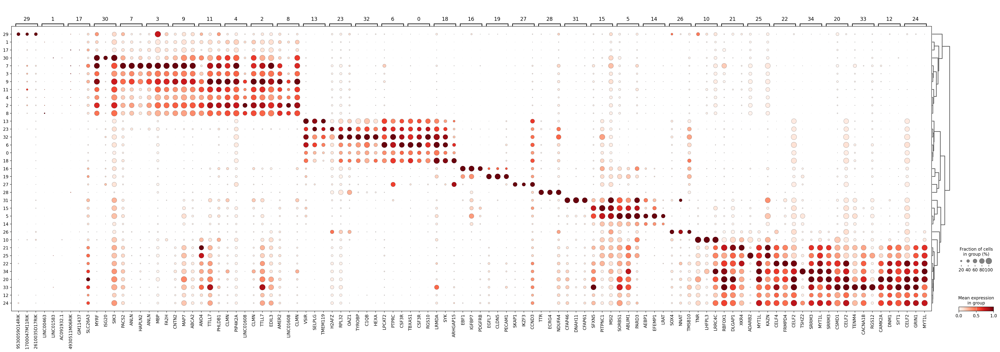

In [68]:
sc.pl.rank_genes_groups_dotplot(adata_all, n_genes=3, key='rank_genes_annotated',
                               standard_scale='var') #save='_scVI_ctrl_annotated.pdf')

In [69]:
result = adata_all.uns['rank_genes_annotated']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [70]:
adata_annotated_genes.to_csv('./h2m_adata_all_leiden1_rank_genes.csv')

In [73]:
adata_all.write_h5ad('./h2m_all_TEMP.h5ad')

# Complete cluster naming and plotting

In [89]:
# Filter the data where 'sys_leiden_1' equals 23
filtered_data = adata_all[adata_all.obs['sys_leiden_1'] == '27']

# Get the value counts for the 'cell_type_eval' column
cell_type_counts = filtered_data.obs['cell_type_eval'].value_counts()

print(cell_type_counts)

cell_type_eval
t cells                 1503
b cells                  929
unknown                  253
microglia                129
endo + peri               49
mixed ol + microglia      18
oligodendrocytes          12
astrocytes                 3
choroid plexus             1
inhibitory neurons         1
opcs + cops                1
Name: count, dtype: int64

In [90]:
cluster_1_annotation = {
    '0': 'Microglia',
    '1': 'MOL',
    '2': 'MOL',
    '3': 'MOL',
    '4': 'MOL',
    '5': 'Astrocytes',
    '6': 'Microglia',
    '7': 'MOL',
    '8': 'MOL',
    '9': 'MOL',
    '10': 'OPCs',
    '11': 'MOL',
    '12': 'Neurons',
    '13': 'Microglia',
    '14': 'Astrocytes',
    '15': 'Astrocytes',
    '16': 'EC+Pericyte',
    '17': 'MOL',
    '18': 'Microglia',
    '19': 'EC+Pericyte',
    '20': 'Neurons',
    '21': 'Neurons',
    '22': 'Neurons',
    '23': 'Microglia',
    '24': 'Neurons',
    '25': 'Neurons',
    '26': 'NSCs',
    '27': 'T/B cells',
    '28': 'Choroid plexus',
    '29': 'COPs',
    '30': 'MOL',
    '31': 'Ependymal cells',
    '32': 'Microglia',
    '33': 'Neurons',
    '34': 'Neurons'
}

In [91]:
adata_all.obs['cluster_annotation'] = adata_all.obs['sys_leiden_1'].map(cluster_1_annotation).astype('category')

In [92]:
adata_all.obs['cluster_annotation'].value_counts()

cluster_annotation
MOL                229363
Microglia           91496
Astrocytes          39382
Neurons             34529
OPCs                15527
EC+Pericyte         11903
NSCs                 2960
T/B cells            2899
Choroid plexus       2007
COPs                 1998
Ependymal cells      1519
Name: count, dtype: int64

In [98]:
cluster2annotation = {
    '0': '0_Microglia',
    '1': '1_MOL',
    '2': '2_MOL',
    '3': '3_MOL',
    '4': '4_MOL',
    '5': '5_Astrocytes',
    '6': '6_Microglia',
    '7': '7_MOL',
    '8': '8_MOL',
    '9': '9_MOL',
    '10': '10_OPCs',
    '11': '11_MOL',
    '12': '12_Neurons',
    '13': '13_Microglia',
    '14': '14_Astrocytes',
    '15': '15_Astrocytes',
    '16': '16_EC+Pericyte',
    '17': '17_MOL',
    '18': '18_Microglia',
    '19': '19_EC+Pericyte',
    '20': '20_Neurons',
    '21': '21_Neurons',
    '22': '22_Neurons',
    '23': '23_Microglia',
    '24': '24_Neurons',
    '25': '25_Neurons',
    '26': '26_NSCs',
    '27': '27_T/B cells',
    '28': '28_Choroid plexus',
    '29': 'COP',
    '30': '30_MOL',
    '31': '31_Ependymal cells',
    '32': '32_Microglia',
    '33': '33_Neurons',
    '34': '34_Neurons'  
}

In [99]:
adata_all.obs['cell_leiden_annotated'] = adata_all.obs['sys_leiden_1'].map(cluster2annotation).astype('category')

In [100]:
adata_all.obs['cell_leiden_annotated'].value_counts()

cell_leiden_annotated
0_Microglia           46439
1_MOL                 45302
2_MOL                 44937
3_MOL                 38709
4_MOL                 26658
5_Astrocytes          24971
6_Microglia           24550
7_MOL                 16823
8_MOL                 16724
9_MOL                 16651
10_OPCs               15527
11_MOL                15214
12_Neurons            12937
13_Microglia           9344
14_Astrocytes          7720
15_Astrocytes          6691
16_EC+Pericyte         6582
17_MOL                 6446
18_Microglia           6180
19_EC+Pericyte         5321
20_Neurons             4764
21_Neurons             4431
22_Neurons             4412
23_Microglia           4083
24_Neurons             3823
25_Neurons             3069
26_NSCs                2960
27_T/B cells           2899
28_Choroid plexus      2007
29_COPs                1998
30_MOL                 1899
31_Ependymal cells     1519
32_Microglia            900
33_Neurons              603
34_Neurons              49

In [154]:
cluster_color = {
    '0': '#000066',  # Microglia
    '1': '#ff3399',  # MOL
    '2': '#990066',  # MOL
    '3': '#ff6666',  # MOL
    '4': '#ff3333',  # MOL
    '5': '#9AD255',  # Astro
    '6': '#0066ff',  # Microglia
    '7': '#ff99cc',  # MOL
    '8': '#cc0099',  # MOL
    '9': '#cc3333',  # MOL
    '10': '#660099',  # OPCs
    '11': '#ff6699',  # MOL
    '12': '#ff9966',  # Neurons
    '13': '#00ffff',  # Microglia
    '14': '#20B2AA',  # Astro
    '15': '#008000',  # Astr
    '16': '#dada2b',  # EC+Peri
    '17': '#cc0066',  # MOL
    '18': '#00ccff',  # Microglia
    '19': '#9AD255',  # EC+Peri
    '20': '#ffcc00',  # Neurons
    '21': '#ff9933',  # Neurons
    '22': '#ff9900',  # Neurons
    '23': '#0000ff',  # Microglia
    '24': '#ff9900',  # Neurons
    '25': '#cc3300',  # Neurons
    '26': '#cc66ff',  # NSCs
    '27': '#ff6666',  # T/B cells
    '28': '#cc9900',  # Choroid plexus
    '29': '#cc66cc',  # COP
    '30': '#cc99ff',  # MOL
    '31': '#bdb76b',   # Ependymal,
    '32': '#cc66ff',   # Microglia,
    '33': '#ffcc66',   # Neurons,
    '34': '#ffff00'   # Neurons
}

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


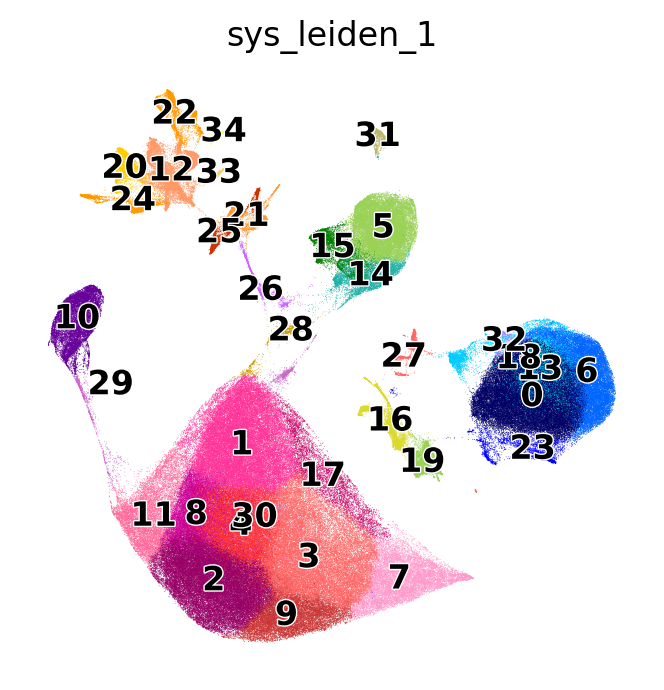

In [155]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['sys_leiden_1'], legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,palette=cluster_color,legend_loc='on data',
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1) #save=today+'_leiden_ctrl.pdf' )

In [158]:
cluster_color = {
    '0_Microglia': '#000066',
    '1_MOL': '#ff3399',
    '2_MOL': '#990066',
    '3_MOL': '#ff6666',
    '4_MOL': '#ff3333',
    '5_Astrocytes': '#9AD255',
    '6_Microglia': '#0066ff',
    '7_MOL': '#ff99cc',
    '8_MOL': '#cc0099',
    '9_MOL': '#cc6699',
    '10_OPCs': '#660099',
    '11_MOL': '#ff6699',
    '12_Neurons': '#ff9966',
    '13_Microglia': '#00ffff',
    '14_Astrocytes': '#20B2AA',
    '15_Astrocytes': '#008000',
    '16_EC+Pericyte': '#dada2b',
    '17_MOL': '#cc0066',
    '18_Microglia': '#00ccff',
    '19_EC+Pericyte': '#9AD255',
    '20_Neurons': '#ffcc00',
    '21_Neurons': '#ff9933',
    '22_Neurons': '#ff9900',
    '23_Microglia': '#0000ff',
    '24_Neurons': '#ff9900',
    '25_Neurons': '#cc3300',
    '26_NSCs': '#cc66ff',
    '27_T/B cells': '#ff6666',
    '28_Choroid plexus': '#cc9900',
    '29_COPs': '#cc66cc',
    '30_MOL': '#cc99ff',
    '31_Ependymal cells': '#bdb76b',
    '32_Microglia': '#cc66ff',
    '33_Neurons': '#ffcc66',
    '34_Neurons': '#ffff00'
}

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


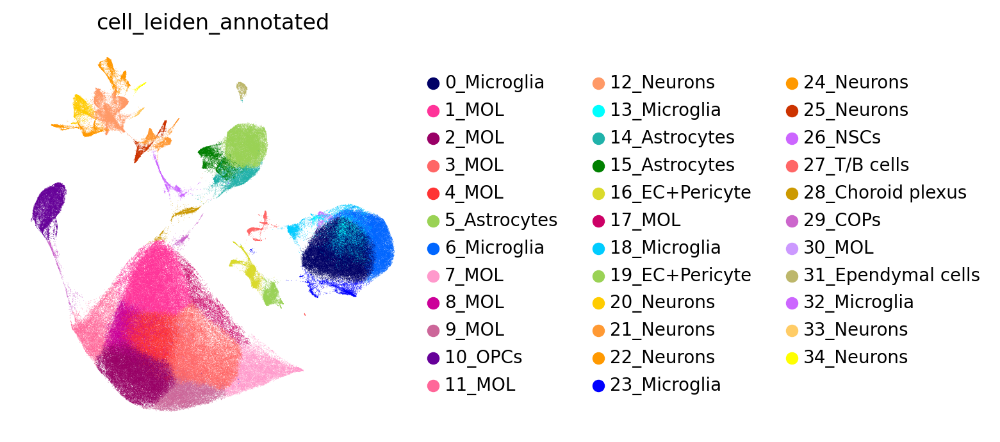

In [159]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cell_leiden_annotated'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,palette=cluster_color,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1) #save=today+'_annotated_ctrl.pdf' )

In [160]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['cluster_annotation'].unique()
for condition in unique_conditions:
    print(condition)

Neurons

COPs

MOL

OPCs

Microglia

Astrocytes

NSCs

Ependymal cells

EC+Pericyte

T/B cells

Choroid plexus

In [29]:
cluster_simplified_color = {
    'Neurons': '#ffcc00',
    'COPs': '#cc66cc',
    'MOL': '#cc6699',
    'OPCs': '#660099',
    'Microglia': '#0066ff',
    'Astrocytes': '#008000',
    'NSCs': '#cc66ff',
    'Ependymal cells': '#bdb76b',
    'EC+Pericyte': '#dada2b',
    'T/B cells': '#ff6666',
    'Choroid plexus': '#cc9900'
}

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


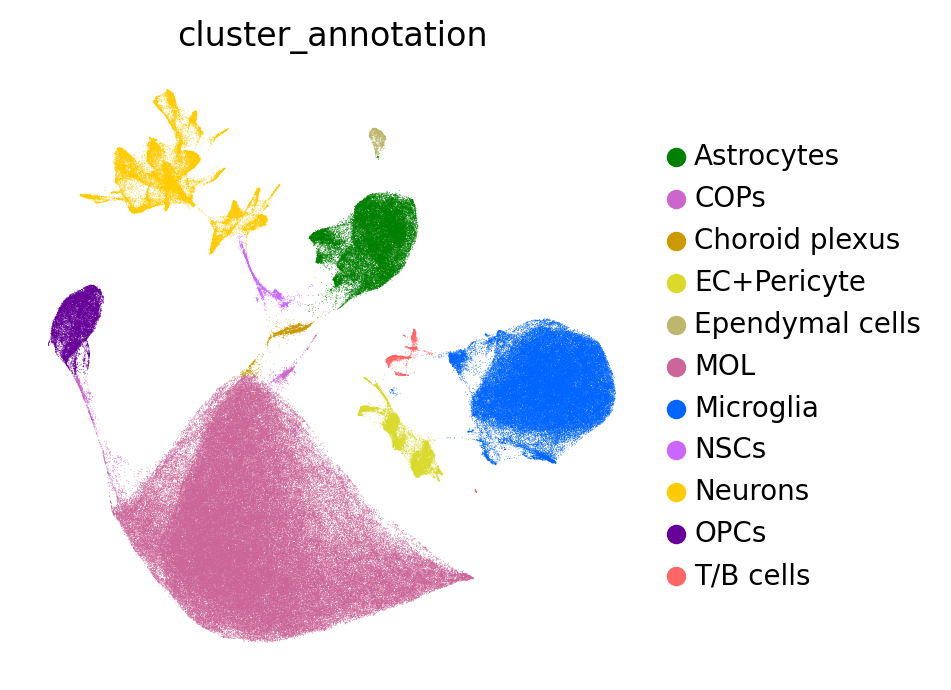

In [173]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cluster_annotation'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,palette=cluster_simplified_color,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1) #save=today+'_annotated_ctrl.pdf' )

# Plot cell annotation by publication 

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


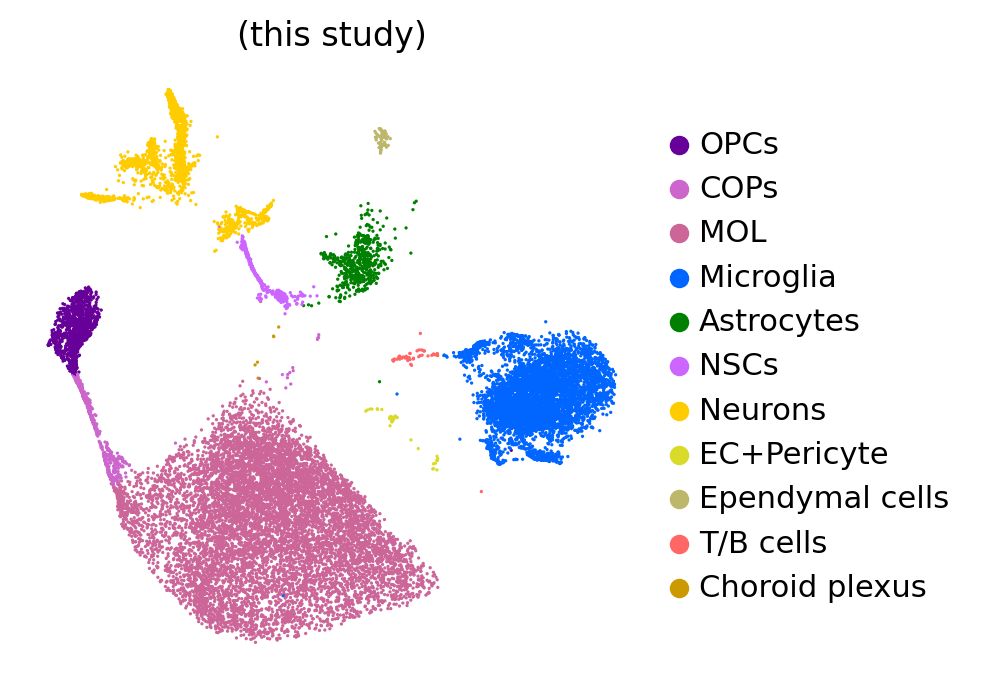

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


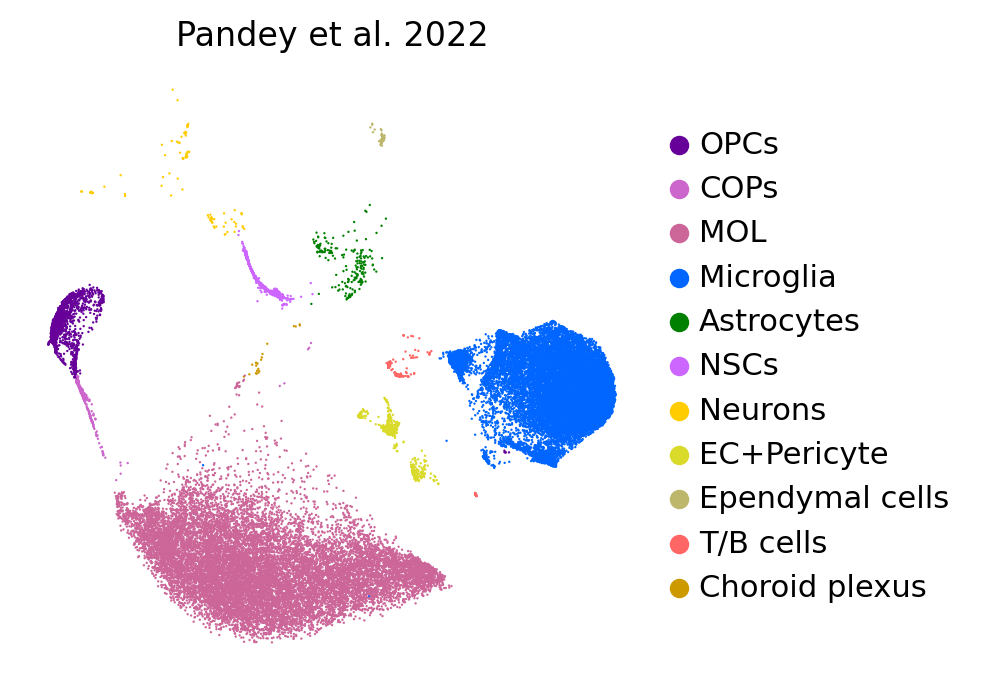

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


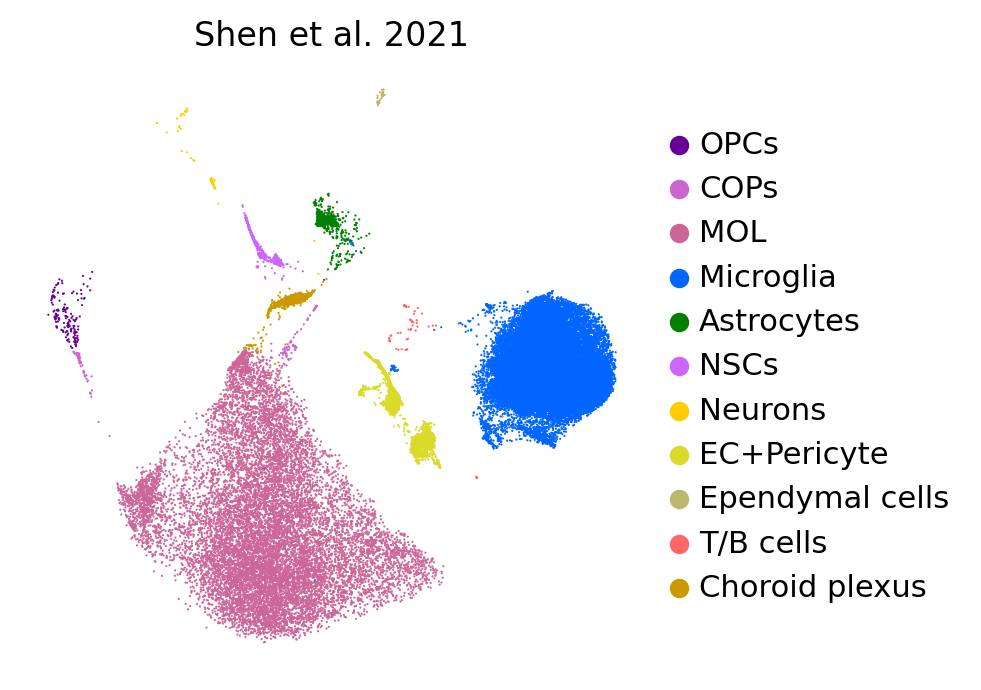

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_utils.py:432: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


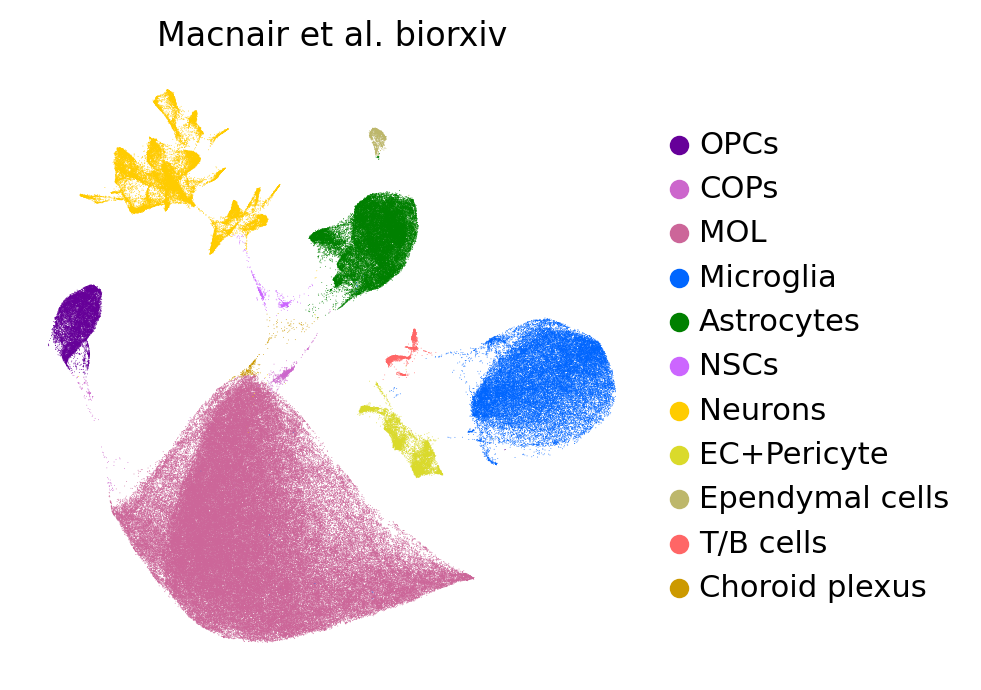

In [30]:
# Plot each dataset separately
for publication in adata.obs['publication'].unique():
    subset_data = adata[adata.obs['publication'] == publication, :]
    filename = f"{publication}_h2m_broad_cell_types_by_publication"  # Unique filename for each plot
    sc.pl.umap(
        subset_data,
        color=["cluster_annotation"],
        cmap=mymap2,
        palette=cluster_simplified_color,  # Use the predefined color mapping
        title=publication,
        frameon=False,
        ncols=1,
        #save=filename,  # Save with the unique filename
    )

 # Downsampling

In [10]:
adata_all.obs['lesion_status'].value_counts()

lesion_status
MS_AL                      71049
MS_NAWM                    58176
MS_CAL                     57991
hs_WM                      53729
MS_RL                      42972
MS_CIL                     37649
Cuprizone_4w               19058
Normal_chow2               16309
LPC_5dpl                   14365
Cuprizone_remyelination    13329
LPC_remyelination          10082
No_lesion                   9566
LPC_14dpl                   7925
LPC_7dpl                    7033
Saline                      6220
Cuprizone_5w                4614
Normal_chow                 3516
Name: count, dtype: int64

In [12]:
MS_AL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_AL'],n_obs=3516,copy=True).obs_names
MS_NAWM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_NAWM'],n_obs=3516,copy=True).obs_names
MS_CAL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CAL'],n_obs=3516,copy=True).obs_names
hs_WM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='hs_WM'],n_obs=3516,copy=True).obs_names
MS_RL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_RL'],n_obs=3516,copy=True).obs_names
MS_CIL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CIL'],n_obs=3516,copy=True).obs_names

Cuprizone_4w = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_4w'],n_obs=3516,copy=True).obs_names
Normal_chow2 = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Normal_chow2'],n_obs=3516,copy=True).obs_names
LPC_5dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_5dpl'],n_obs=3516,copy=True).obs_names
Cuprizone_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_remyelination'],n_obs=3516,copy=True).obs_names
LPC_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_remyelination'],n_obs=3516,copy=True).obs_names
No_lesion = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='No_lesion'],n_obs=3516,copy=True).obs_names
LPC_14dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_14dpl'],n_obs=3516,copy=True).obs_names
LPC_7dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_7dpl'],n_obs=3516,copy=True).obs_names
Saline = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Saline'],n_obs=3516,copy=True).obs_names
Cuprizone_5w = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_5w'],n_obs=3516,copy=True).obs_names
Normal_chow = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Normal_chow'],n_obs=3516,copy=True).obs_names

In [13]:
adata_all_subsample = adata_all[list(Cuprizone_4w) + list(Normal_chow2) + list(LPC_5dpl) +
                                list(Cuprizone_remyelination) + list(LPC_remyelination) + list(No_lesion) +
                                list(LPC_14dpl) + list(LPC_7dpl) + list(Saline) + list(Cuprizone_5w) + 
                                list(Normal_chow) +
                                list(hs_WM) + list(MS_AL) + list(MS_NAWM) + list(MS_CAL) + list(MS_RL) +
                                list(MS_CIL) ].copy()
adata_all_subsample

AnnData object with n_obs × n_vars = 59772 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_r

In [14]:
adata_all_subsample.obs['lesion_status'].value_counts()

lesion_status
Cuprizone_4w               3516
MS_CIL                     3516
Saline                     3516
Normal_chow2               3516
Normal_chow                3516
No_lesion                  3516
MS_RL                      3516
MS_NAWM                    3516
MS_CAL                     3516
Cuprizone_5w               3516
MS_AL                      3516
LPC_remyelination          3516
LPC_14dpl                  3516
LPC_7dpl                   3516
LPC_5dpl                   3516
Cuprizone_remyelination    3516
hs_WM                      3516
Name: count, dtype: int64

In [15]:
sc.tl.embedding_density(adata_all_subsample, basis='umap', groupby='lesion_status')

computing density on 'umap'
--> added
    'umap_density_lesion_status', densities (adata.obs)
    'umap_density_lesion_status_params', parameter (adata.uns)


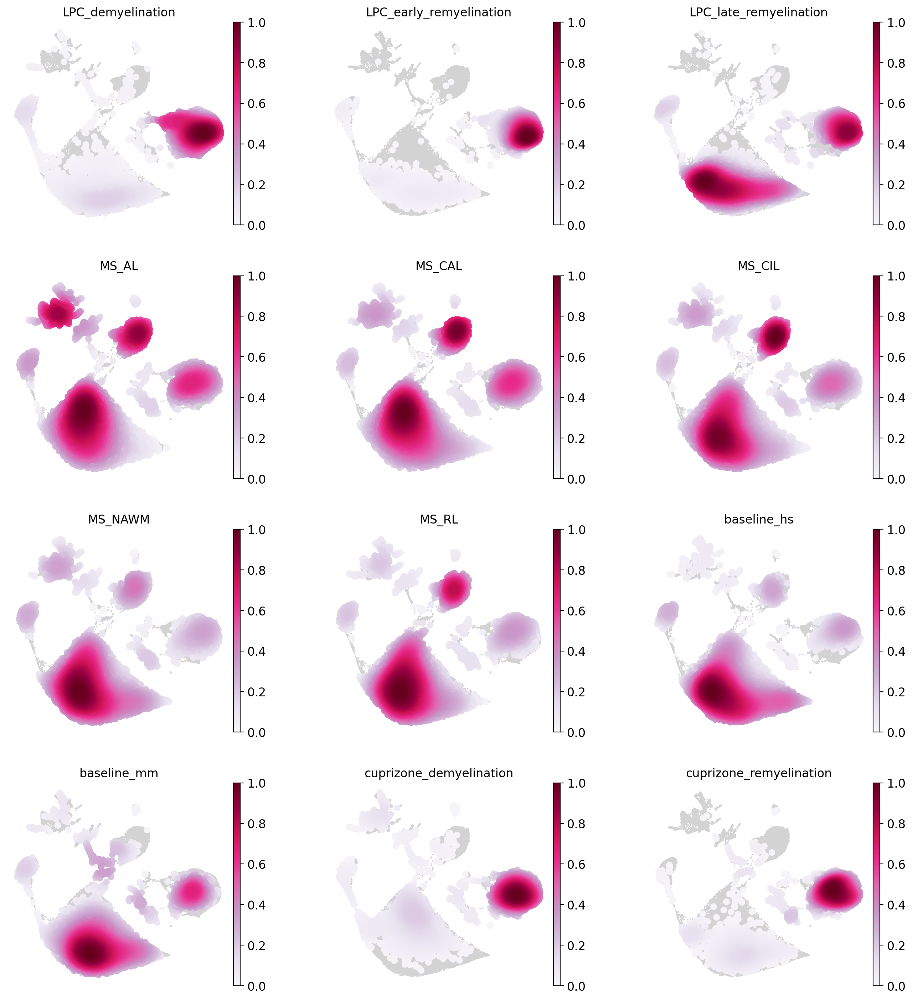

In [183]:
sc.pl.embedding_density(adata_all_subsample, basis='umap',  key='umap_density_lesion_status', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, 
                        ncols=3, save='_distribution_downscaling_all.png')

In [184]:
con_cl = ['#DC143C', '#ff9933', '#20B2AA', '#8A2BE2', '#00CED1', '#FF69B4',
          '#FFA07A', '#7FFF00', '#FF4500', '#4682B4', '#FFD700', '#808080']

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


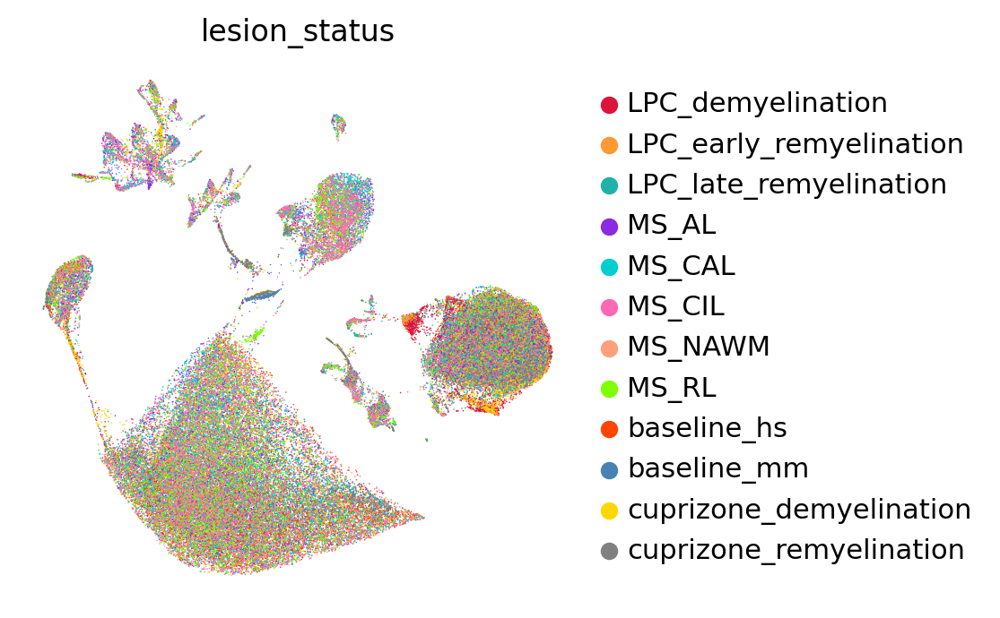

In [185]:
sc.pl.umap(adata_all_subsample,color='lesion_status',palette=con_cl, legend_fontweight= 'normal', frameon= False ,)

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


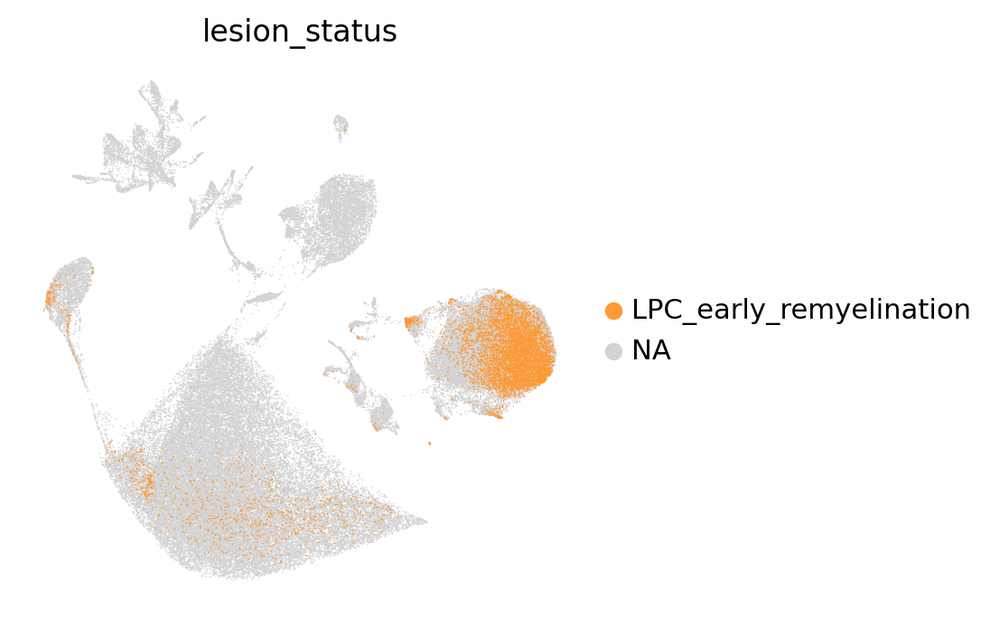

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


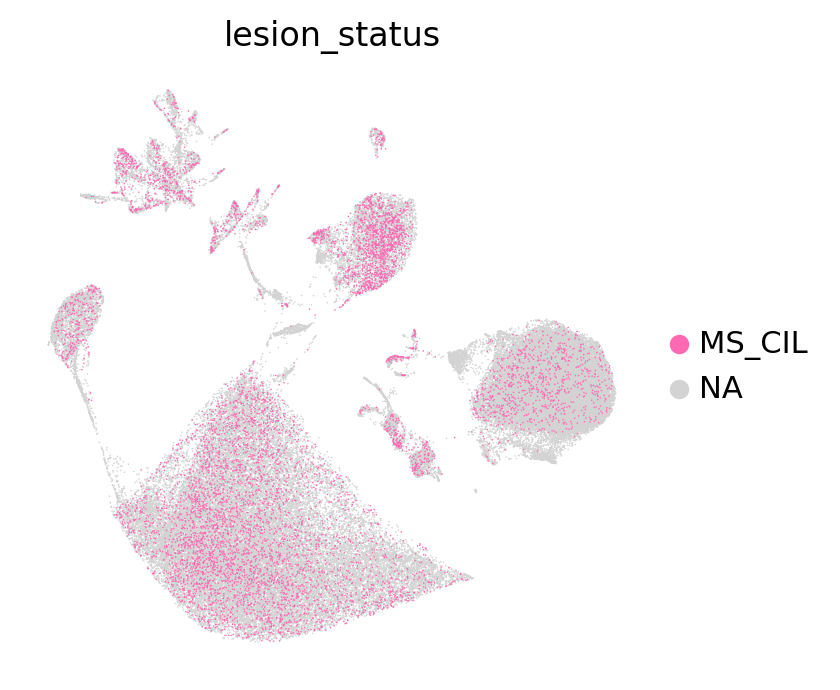

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


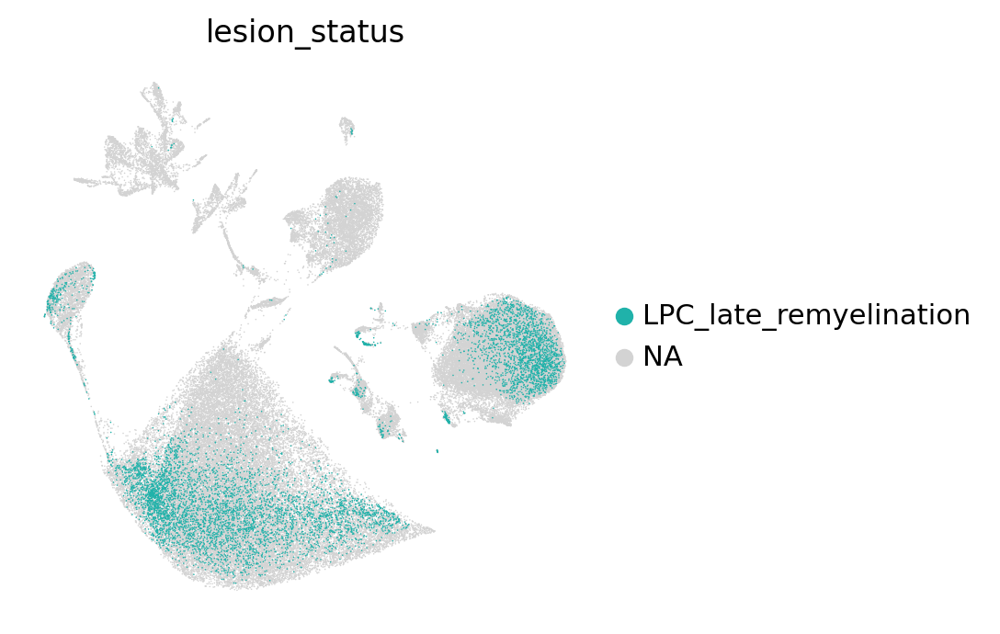

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


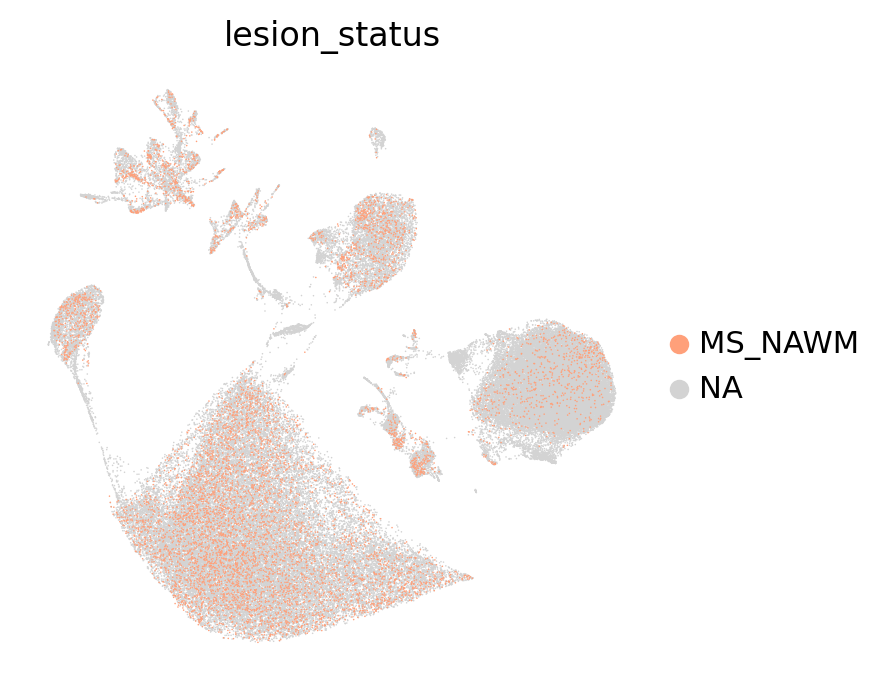

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


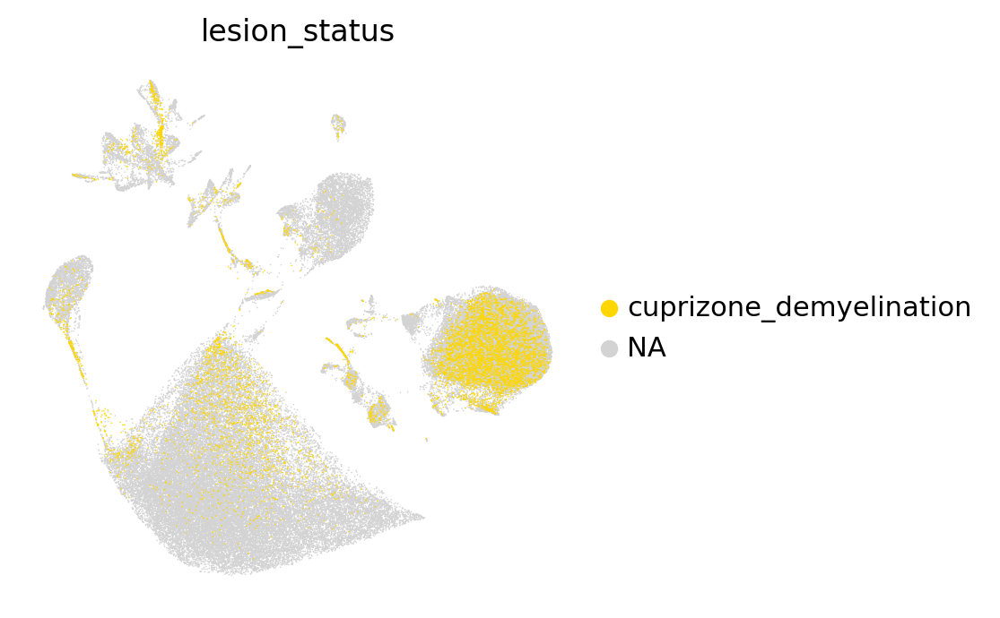

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


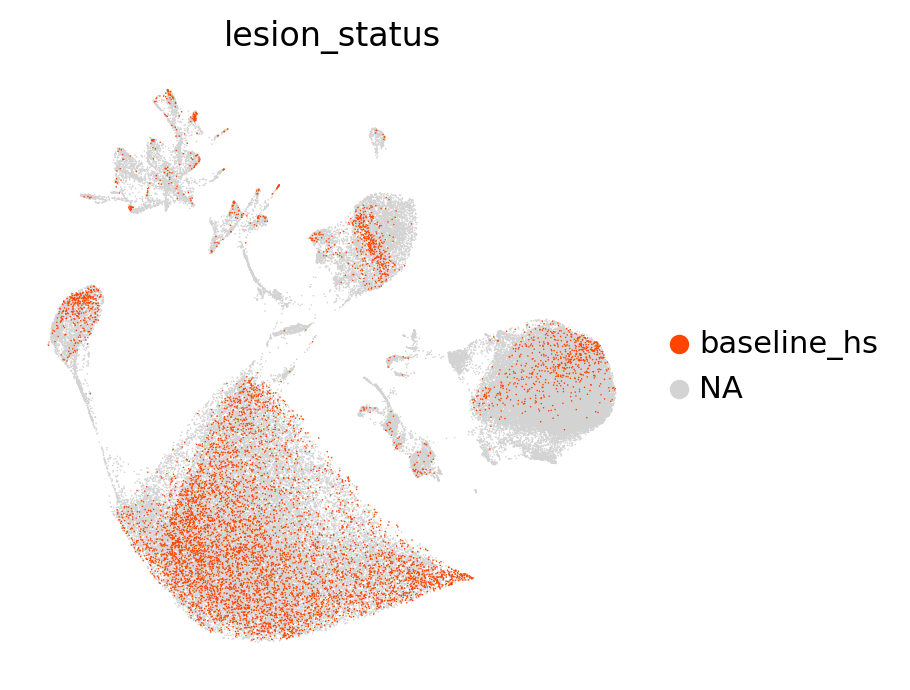

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


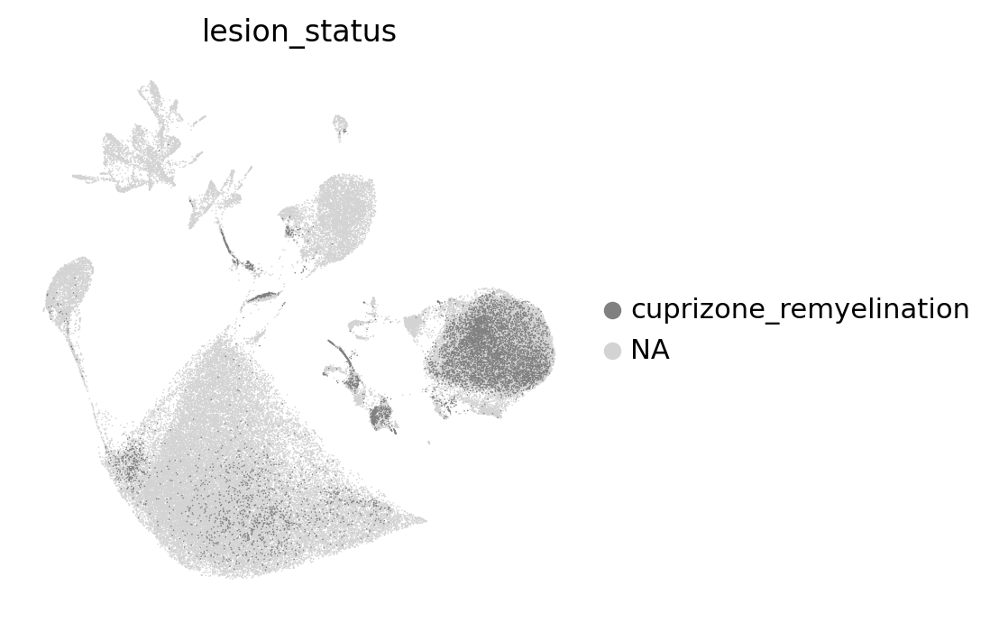

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


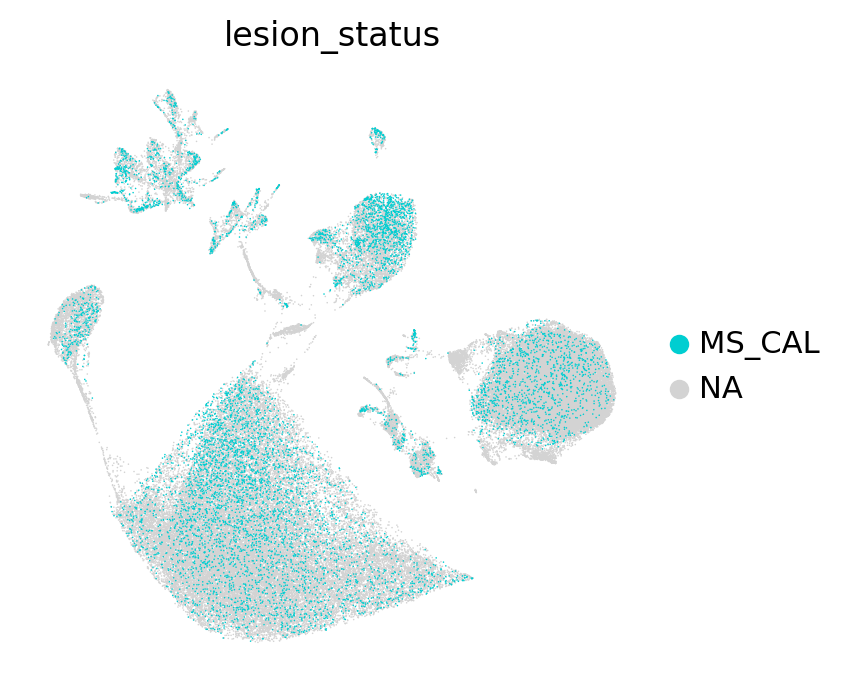

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


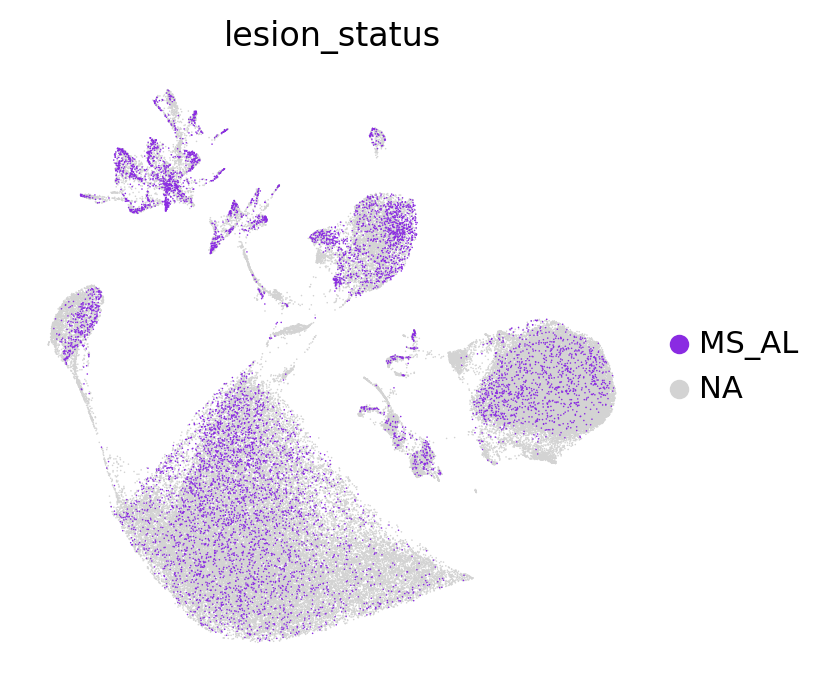

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


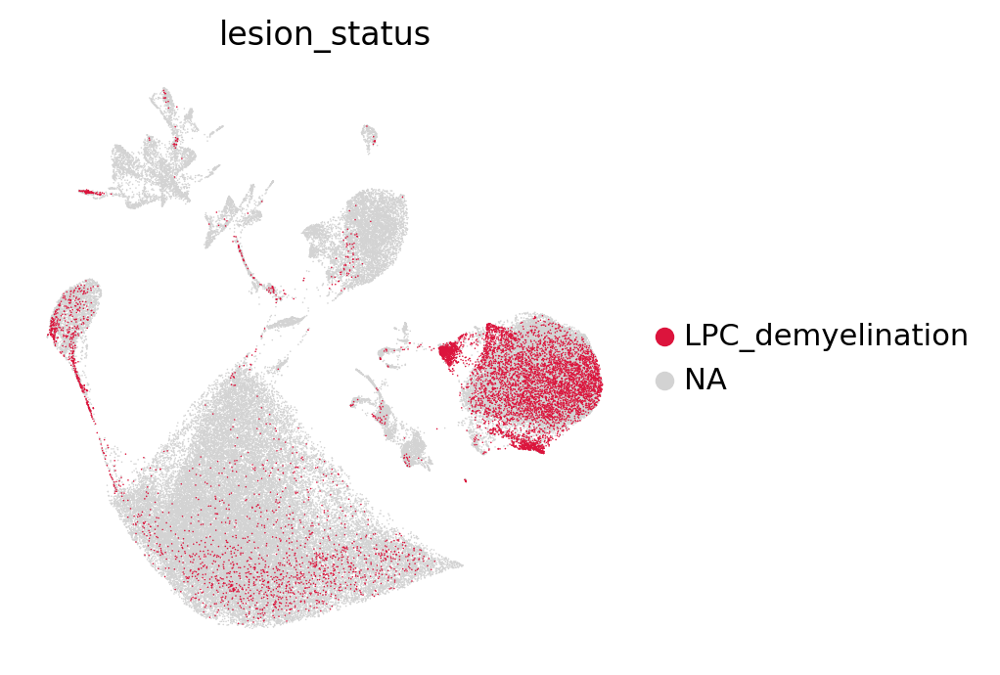

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


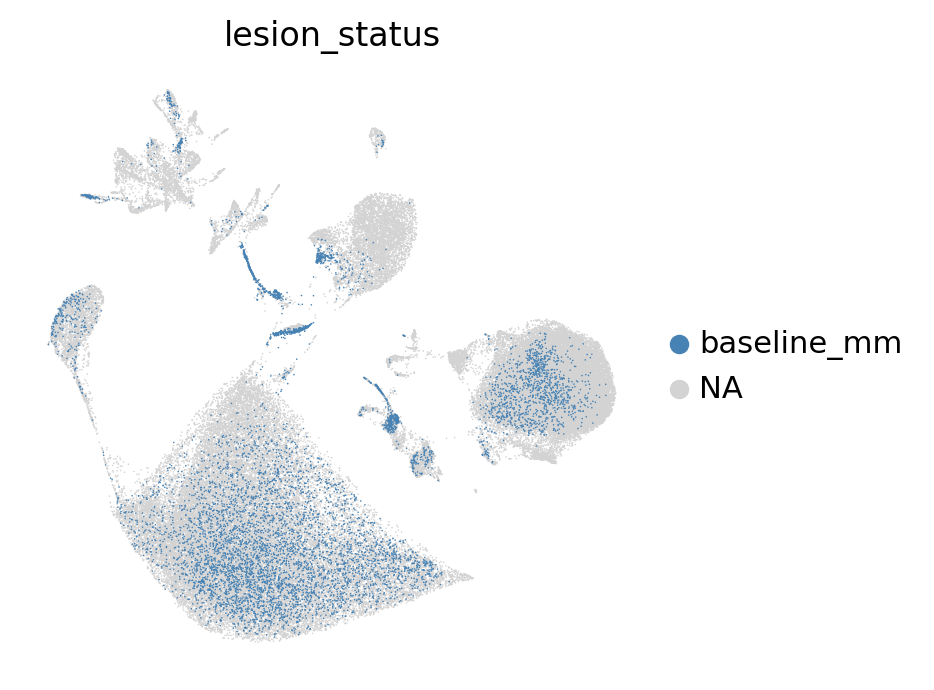

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


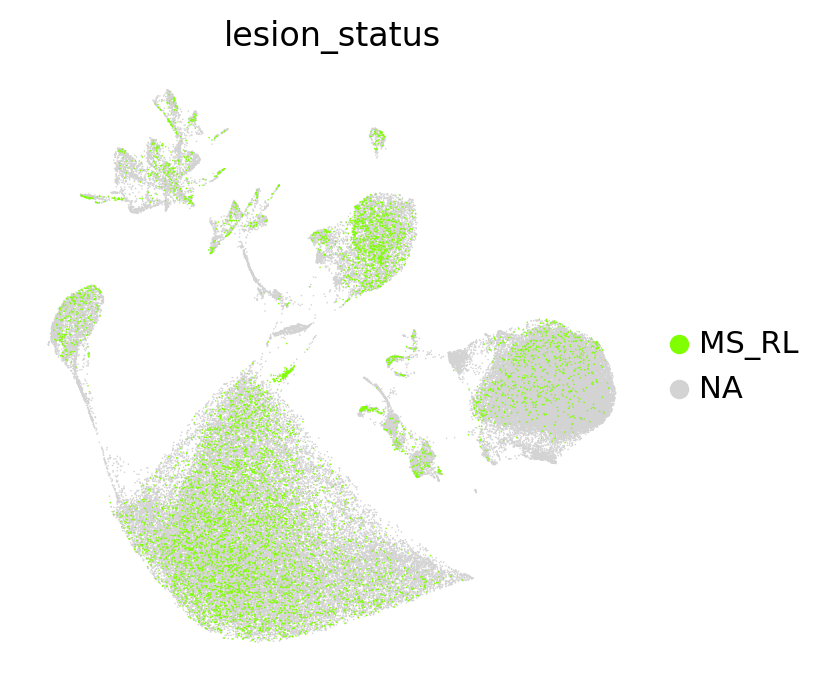

In [186]:
for i in set(adata_all_subsample.obs['lesion_status']):
    sc.pl.umap(adata_all_subsample,color='lesion_status',legend_fontweight= 'normal', frameon= False, groups=i,save=i+'downsampling.png')

In [187]:
adata_all.obs['publication'].value_counts()

publication
Macnair et al. biorxiv    321566
Shen et al. 2021           48696
Pandey et al. 2022         41938
(this study)               21383
Name: count, dtype: int64

In [188]:
pub_1 = sc.pp.subsample(adata_all[adata_all.obs['publication']=='(this study)'],n_obs=21383,copy=True).obs_names
pub_2 = sc.pp.subsample(adata_all[adata_all.obs['publication']=='Pandey et al. 2022'],n_obs=21383,copy=True).obs_names
pub_3 = sc.pp.subsample(adata_all[adata_all.obs['publication']=='Shen et al. 2021'],n_obs=21383,copy=True).obs_names
pub_4 = sc.pp.subsample(adata_all[adata_all.obs['publication']=='Macnair et al. biorxiv'],n_obs=21383,copy=True).obs_names
adata_pub_subsample = adata_all[list(pub_1) + list(pub_2)+list(pub_3)+list(pub_4)].copy()

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


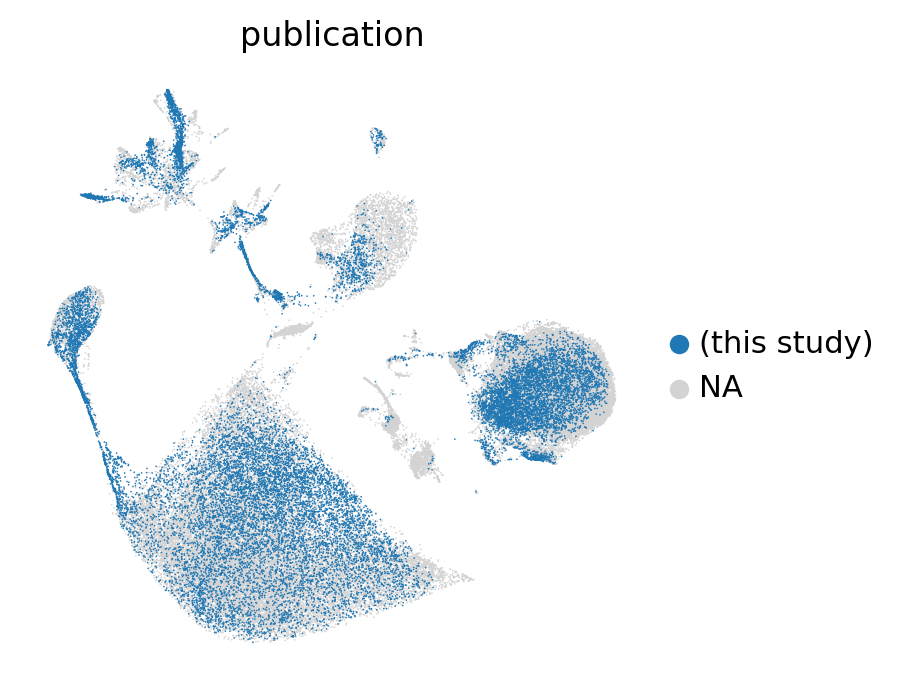

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


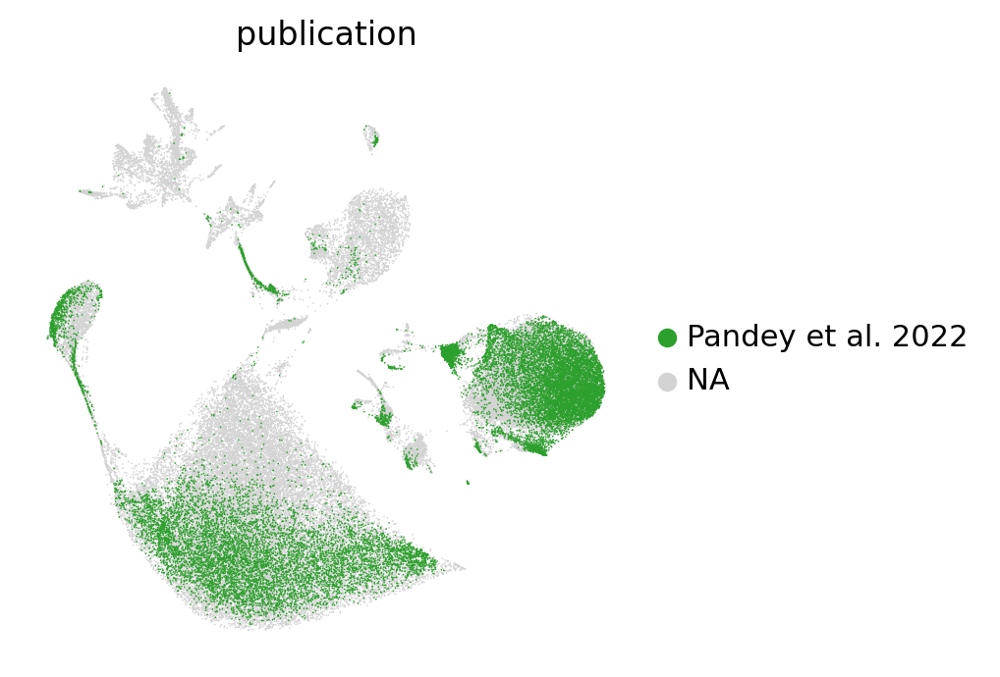

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


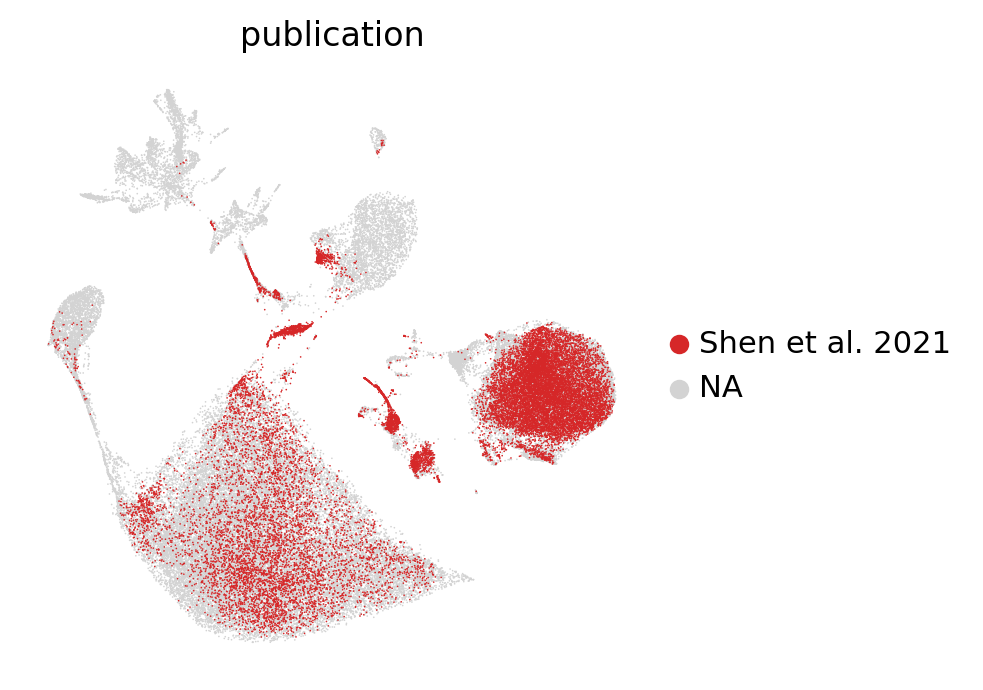

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/sysVI/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


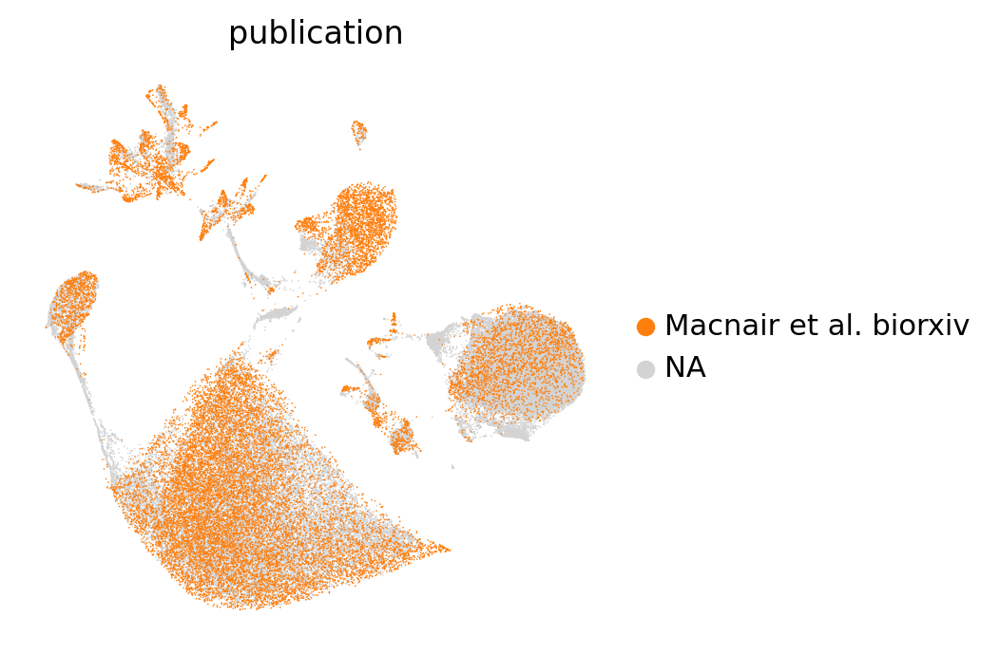

In [190]:
for i in set(adata_pub_subsample.obs['publication']):
    sc.pl.umap(adata_pub_subsample,color='publication',legend_fontweight= 'normal', frameon= False, groups=i,save=i+'downsampling.png')